In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

Main pipeline

Paths

In [14]:
DATASET_NAME = 'auto-annotation/Dataset' 
DATASET_ROOT = os.path.join('/kaggle/input', DATASET_NAME)
IMAGE_DIR = os.path.join(KAGGLE_DATASET_ROOT, 'Images')

# ADD IF LABELS ARE AVAILABLE ELSE NONE
LABEL_DIR = os.path.join(KAGGLE_DATASET_ROOT, 'Labels')
BATCH_SIZE = 1

SAVING_LABELLED_ANNOTATION = "/kaggle/working/annotated_images"

CLASS_MAP = {"car": 0, "bottle": 1, "dog": 2} #adjust as needed

TEXT_INPUT = "car, dog, cat" # add as per needed the prompt/classes to label

LOG_FILE_PATH = "/kaggle/working/florence_output_log.txt" # to save the logs of prediction
SAVE_FILE_PATH = "/kaggle/working/generated_labels" #Directory path to save the predicted labels

Preparing Dataset

In [2]:
import os
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import numpy as np
from tqdm import tqdm

print("--- Checking for CUDA availability ---")
if torch.cuda.is_available():
    device = torch.device("cuda")
    print(f"CUDA is available! Using GPU: {torch.cuda.get_device_name(0)}")
else:
    device = torch.device("cpu")
    print("CUDA is NOT available. Using CPU.")
print("------------------------------------\n")


# --- 1. Define the transform pipeline ---
transform_pipeline = transforms.Compose([
    transforms.Resize((250, 250)),
    transforms.ToTensor(),         
    transforms.Normalize([0.565, 0.566, 0.529], 
                         [0.276, 0.276, 0.298])
])

# --- 2. Define the Custom Dataset Class ---
class ImageAnnotationDataset(Dataset):
    def __init__(self, image_dir, label_dir=None, transform=None):
        """
        Initializes the custom dataset.

        Args:
            image_dir (string): Path to the directory containing image files.
            label_dir (string, optional): Path to the directory containing YOLO format label files (.txt).
                                          If None, no labels will be loaded for evaluation.
            transform (callable, optional): Optional transform to be applied to the images.
        """
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.transform = transform
        
        self.image_files = sorted([f for f in os.listdir(image_dir) 
                                   if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp'))])
        
        if not self.image_files:
            print(f"Warning: No image files found in {image_dir}. Please check your path and file extensions.")
            
        print(f"Dataset initialized with {len(self.image_files)} images.")
        if self.label_dir:
            print(f"Label directory provided: {self.label_dir}")
        else:
            print("No label directory provided. Annotations will not be loaded from files.")


    def __len__(self):
        """
        Returns the total number of images in the dataset.
        """
        return len(self.image_files)

    def __getitem__(self, idx):
        """
        Retrieves an item (image, annotations, original size, img_name) from the dataset at the given index.

        Args:
            idx (int): Index of the item to retrieve.

        Returns:
            tuple: A tuple containing:
                - transformed_image (torch.Tensor): The image after applying transformations.
                - annotations (list of dicts): A list of dictionaries, where each dictionary
                                              represents an object and contains its 'class_id'
                                              and 'bbox_normalized_xyxy' (xmin, ymin, xmax, ymax).
                                              This will be an empty list if labels are not provided/found.
                - original_size (tuple): The original (width, height) of the image before transforms.
        """
        # Construct the full path to the image
        img_name = self.image_files[idx]
        img_path = os.path.join(self.image_dir, img_name)
        
        # Load the image using PIL and convert to RGB (important for consistent channel order)
        image = Image.open(img_path).convert("RGB")
        original_width, original_height = image.size # Store original dimensions

        # Initialize annotations as an empty list; populate if labels are available
        annotations = []
        if self.label_dir: # Check if a label directory was provided
            # Construct the full path to the corresponding YOLO label file.
            # Assumes label files have the same base name as images but with a .txt extension.
            label_name = img_name.rsplit('.', 1)[0] + '.txt'
            label_path = os.path.join(self.label_dir, label_name)

            if os.path.exists(label_path):
                with open(label_path, 'r') as f:
                    for line in f:
                        parts = list(map(float, line.strip().split()))
                        class_id = int(parts[0])
                        # YOLO format: class_id x_center y_center width height (all normalized 0-1)
                        cx, cy, w, h = parts[1:]

                        # Convert normalized cx, cy, w, h to normalized xmin, ymin, xmax, ymax
                        xmin = cx - (w / 2)
                        ymin = cy - (h / 2)
                        xmax = cx + (w / 2)
                        ymax = cy + (h / 2)
                        
                        # Store the parsed annotation
                        annotations.append({
                            'class_id': class_id,
                            'bbox_normalized_xyxy': [xmin, ymin, xmax, ymax]
                        })


        # Apply transformations to the image if a transform pipeline is provided
        if self.transform:
            transformed_image = self.transform(image)
        else:
            # If no transform is given, convert the PIL Image to a PyTorch Tensor
            transformed_image = transforms.ToTensor()(image)

        # Return the transformed image, the parsed annotations, and the original image size.
        # The original image size is crucial for later converting normalized bounding boxes back to pixel coordinates.
        return transformed_image, annotations, (original_width, original_height), img_name


# --- Custom Collate Function for DataLoader ---
def custom_collate_fn(batch):
    """
    Collate function for DataLoader to handle variable-length annotations.
    It stacks images into a tensor and keeps annotations and original sizes
    as lists of their respective items.
    """
    # Each item in 'batch' is (transformed_image, annotations, original_size)
    
    # Stack the images into a single tensor
    # torch.stack will combine (C, H, W) tensors into (B, C, H, W)
    images = torch.stack([item[0] for item in batch])
    
    # Collect annotations and original sizes as lists
    # These are lists of lists/tuples, maintaining their individual structure per image
    annotations = [item[1] for item in batch]
    original_sizes = [item[2] for item in batch]
    img_names = [item[3] for item in batch]
    
    return images, annotations, original_sizes, img_names


--- Checking for CUDA availability ---
CUDA is available! Using GPU: Tesla P100-PCIE-16GB
------------------------------------



In [5]:
# --- Main Running Part ---



print("\n--- Initializing and Preparing Dataset ---")
try:
    # Initialize the dataset with your image and label directories
    dataset_for_annotation = ImageAnnotationDataset(
        image_dir=IMAGE_DIR, 
        label_dir=LABEL_DIR, 
        transform=transform_pipeline
    )

    if len(dataset_for_annotation) > 0:
        batch_size = BATCH_SIZE
        
        data_loader = DataLoader(
            dataset_for_annotation, 
            batch_size=batch_size, 
            shuffle=False, 
            num_workers=0,
            collate_fn=custom_collate_fn 
        )

        print(f"\nDataLoader created with batch size: {batch_size}")
        print(f"Total batches to process: {len(data_loader)}")

        # List to hold processed data from the DataLoader
        all_processed_data = []

        print("\n--- Preprocessing images... ---")
        for i, (images, annotations, original_sizes, img_names) in enumerate(tqdm(data_loader, desc="Preprocessing Images")):
            
            all_processed_data.append({
                "images": images,
                "annotations": annotations,
                "original_sizes": original_sizes, 
                "img_names": img_names
            })
        
        print(f"\n--- Preprocessing complete for {len(dataset_for_annotation)} images ---")
        print(f"Number of batches collected: {len(all_processed_data)}") # Will be 1 if batch_size=len(dataset)

    else:
        print("The dataset is empty. Please verify your image directory path and contents.")

except FileNotFoundError as e:
    print(f"Error: A required directory or file was not found. Please check paths. {e}")
    print(f"Expected image directory: {IMAGE_DIR}")
    if LABEL_DIR:
        print(f"Expected label directory: {LABEL_DIR}")
except Exception as e:
    print(f"An unexpected error occurred: {e}")


--- Initializing and Preparing Dataset ---
Dataset initialized with 15 images.
Label directory provided: /kaggle/input/auto-annotation/Dataset/Labels

DataLoader created with batch size: 1
Total batches to process: 15

--- Preprocessing images... ---


Preprocessing Images: 100%|██████████| 15/15 [00:00<00:00, 306.53it/s]


--- Preprocessing complete for 15 images ---
Number of batches collected: 15


Visualizing current images with labels if labels are avaible

In [7]:
import os
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import torch
import cv2

def visualize_annotations_from_dataloader_and_save(dataloader, class_map, save_dir=None):
    """
    Visualize YOLO-style annotations from a DataLoader using Matplotlib.

    Args:
        dataloader: Yields (images, annotations_batch, original_sizes, filenames).
        class_map: Dictionary mapping class ID to class name.
        save_dir: If provided, saves the annotated image with original filename.
    """
    if save_dir:
        os.makedirs(save_dir, exist_ok=True)

    for images, annotations_batch, original_sizes, filenames in dataloader:
        batch_size = images.size(0)

        for i in range(batch_size):
            image_tensor = images[i].cpu()
            annotation_list = annotations_batch[i]
            orig_w, orig_h = original_sizes[i]
            filename = filenames[i]

            # Denormalize image
            mean = torch.tensor([0.565, 0.566, 0.529]).view(3, 1, 1)
            std = torch.tensor([0.276, 0.276, 0.298]).view(3, 1, 1)
            image_tensor = image_tensor * std + mean
            image_np = image_tensor.permute(1, 2, 0).numpy()
            image_np = np.clip(image_np * 255, 0, 255).astype(np.uint8)
            image_np = cv2.resize(image_np, (orig_w, orig_h))

            # Create plot
            fig, ax = plt.subplots(figsize=(8, 8))
            ax.imshow(image_np)

            if not annotation_list:
                print(f"No annotations for {filename}")

            for ann in annotation_list:
                cls_id = ann['class_id']
                xmin, ymin, xmax, ymax = ann['bbox_normalized_xyxy']
                x1 = int(xmin * orig_w)
                y1 = int(ymin * orig_h)
                x2 = int(xmax * orig_w)
                y2 = int(ymax * orig_h)

                label = class_map.get(cls_id, f"Class {cls_id}")
                rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                         linewidth=2, edgecolor='lime', facecolor='none')
                ax.add_patch(rect)
                ax.text(x1, max(y1 - 5, 5), label, color='black', fontsize=9,
                        bbox=dict(facecolor='yellow', alpha=0.7))

            ax.set_title(filename)
            ax.axis('off')
            plt.tight_layout()

            if save_dir:
                save_path = os.path.join(save_dir, filename)
                plt.savefig(save_path, bbox_inches='tight', pad_inches=0.1)
                plt.show()
                # print(f"Saved: {save_path}")
            else:
                plt.show()


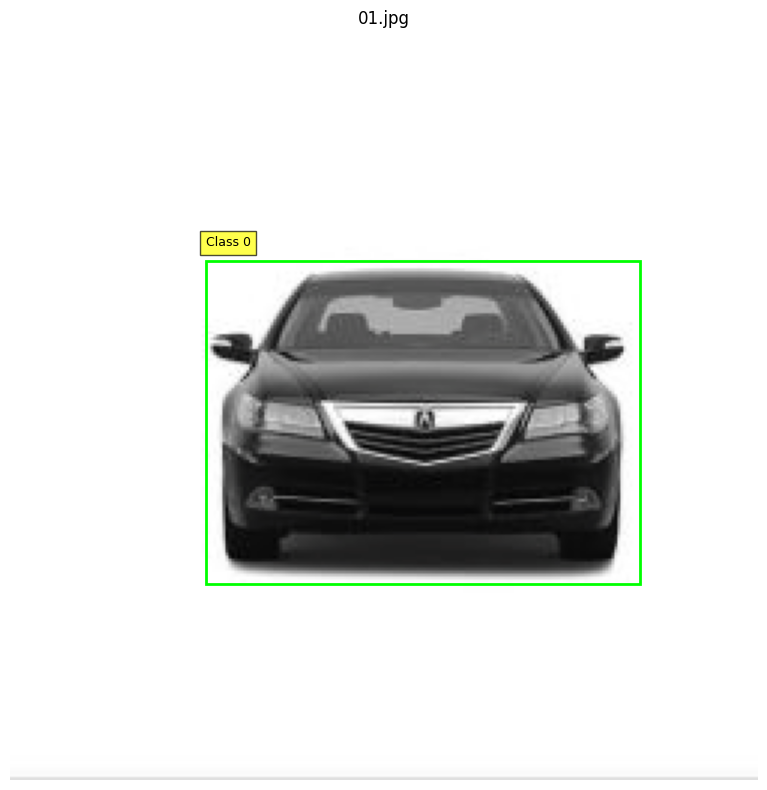

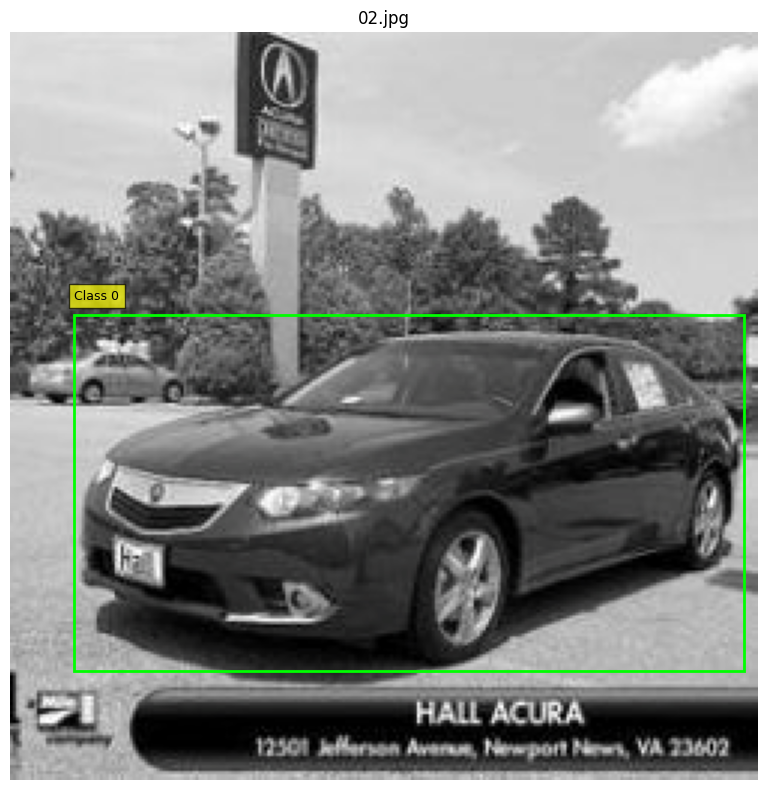

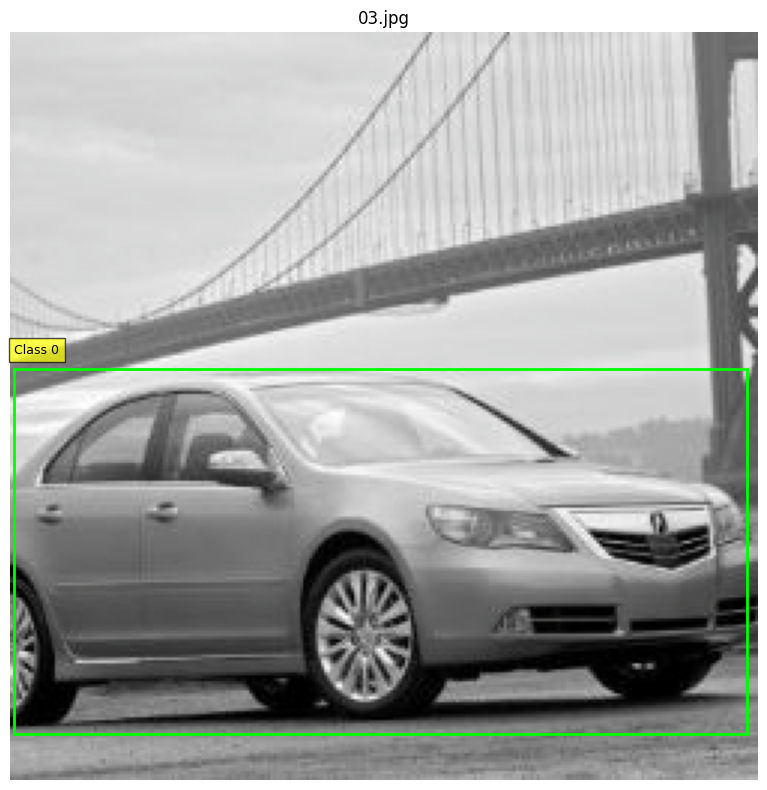

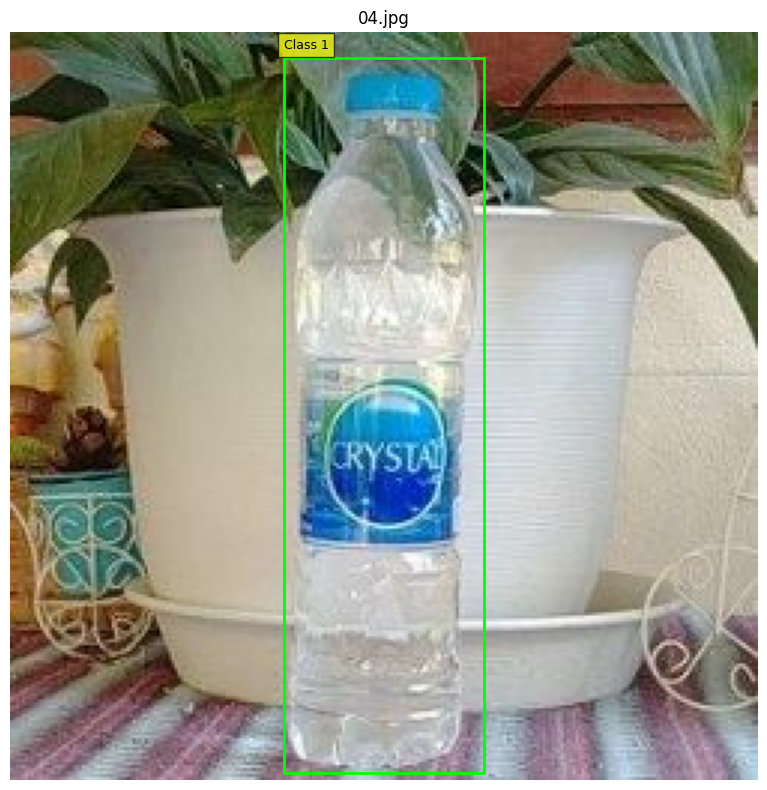

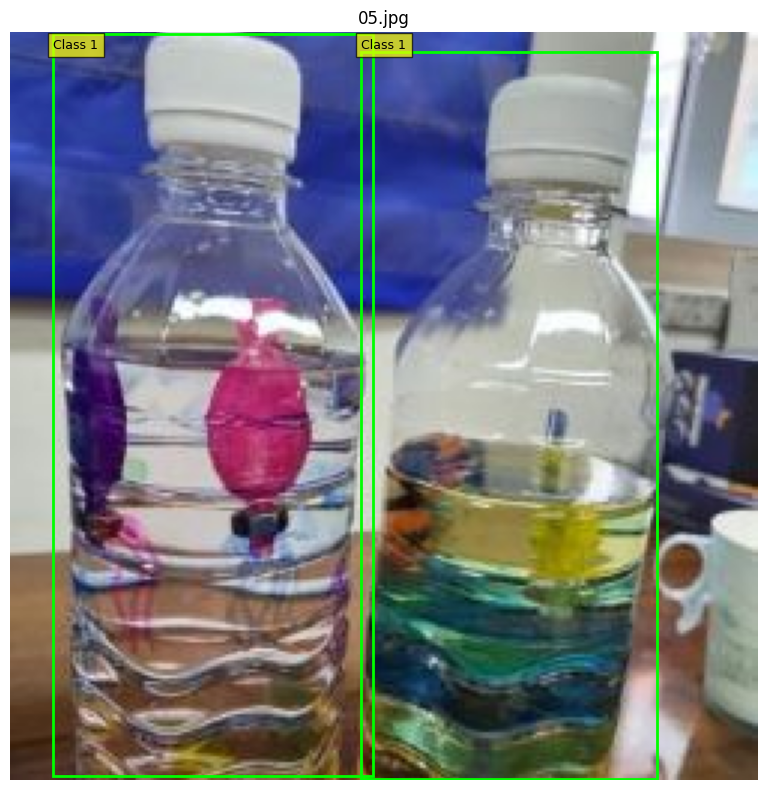

...

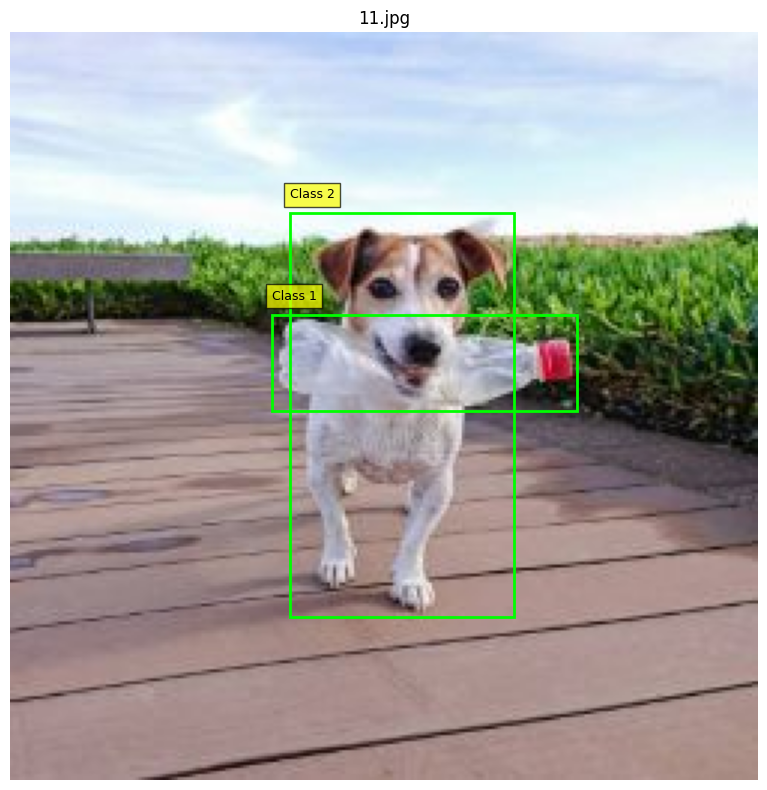

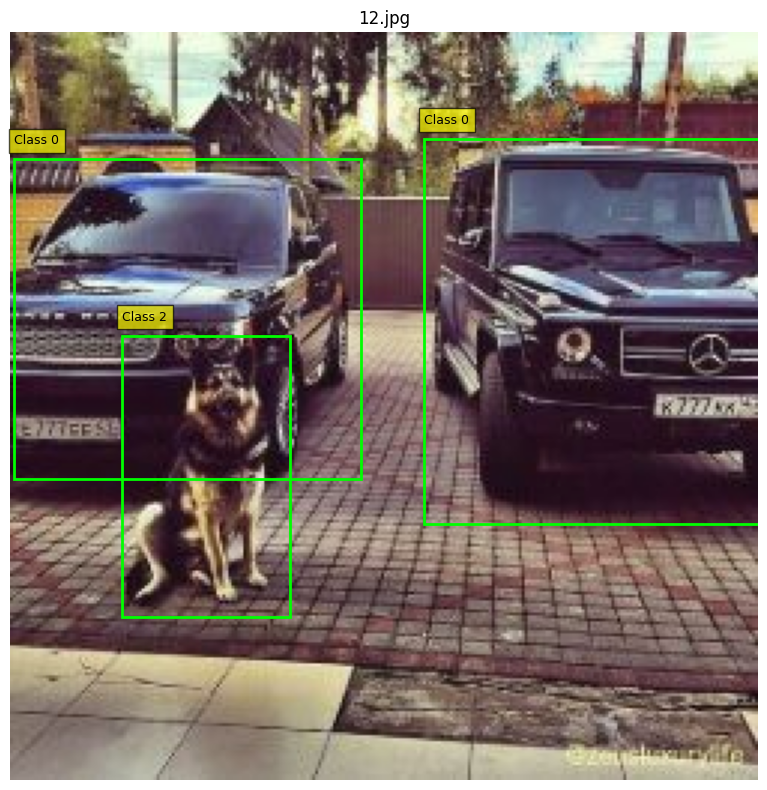

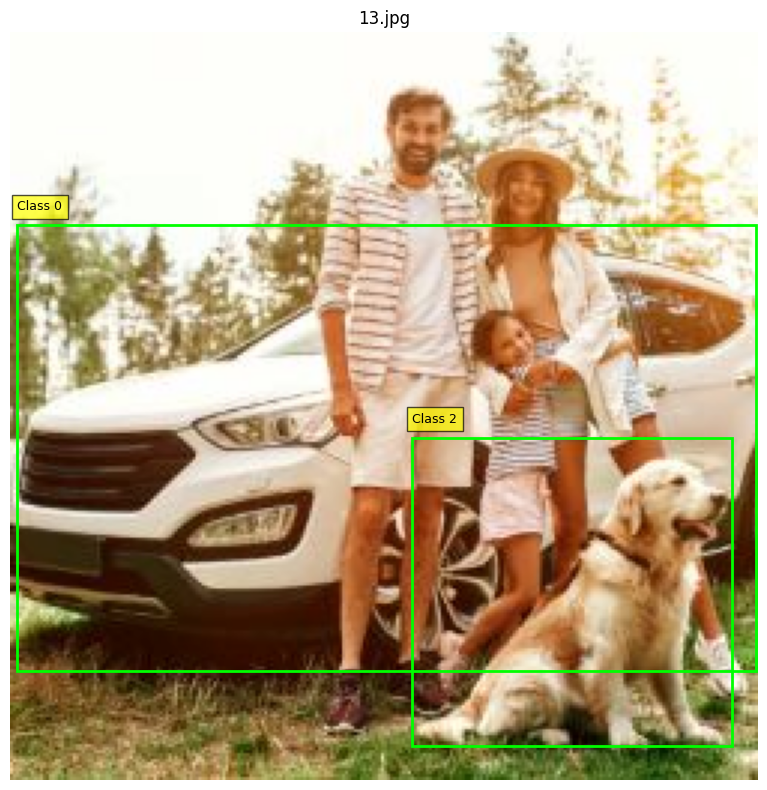

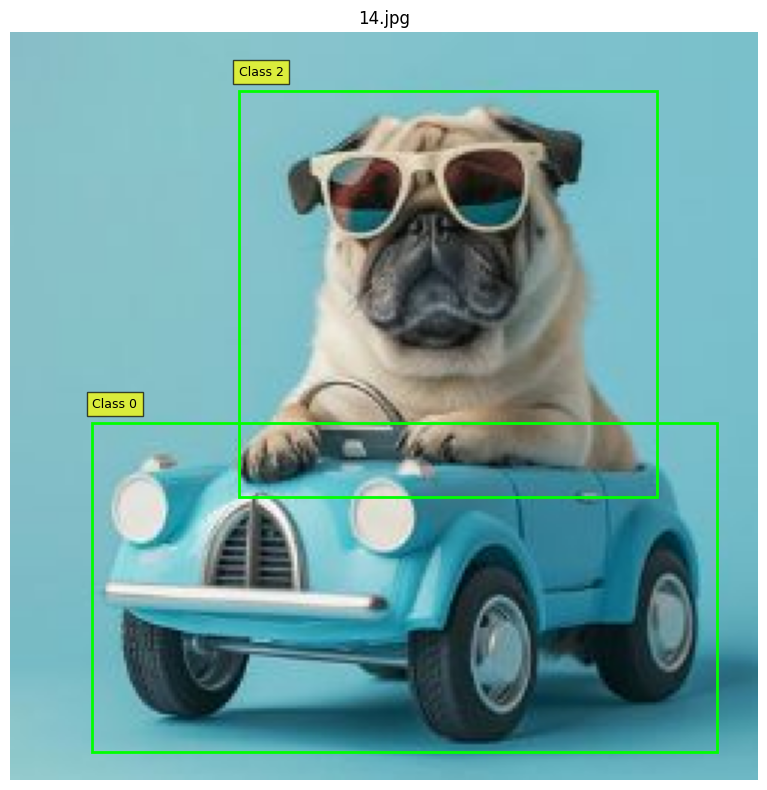

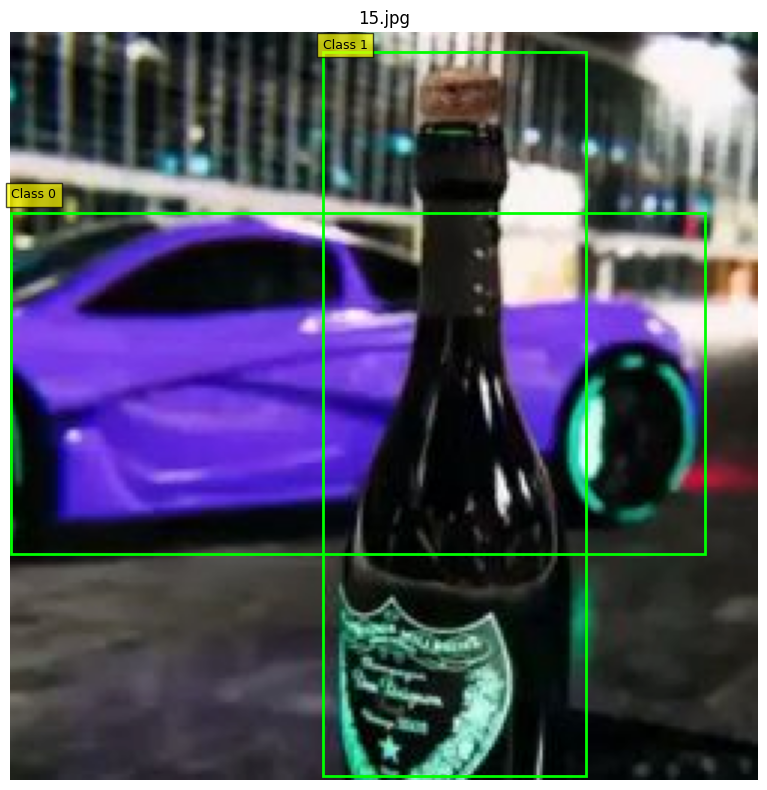

In [11]:
visualize_annotations_from_dataloader_and_save(data_loader, class_map = CLASS_MAP, save_dir=SAVING_LABELLED_ANNOTATION)

Model initialization

In [12]:
from transformers import AutoProcessor, AutoModelForCausalLM  
from PIL import Image
import requests
import copy
import torch
%matplotlib inline  

model_id = 'microsoft/Florence-2-large'
model = AutoModelForCausalLM.from_pretrained(model_id, trust_remote_code=True, torch_dtype='auto').eval().cuda()
processor = AutoProcessor.from_pretrained(model_id, trust_remote_code=True)

2025-06-12 18:15:56.209587: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749752156.536214      35 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749752156.621725      35 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


config.json:   0%|          | 0.00/2.44k [00:00<?, ?B/s]

configuration_florence2.py:   0%|          | 0.00/15.1k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- configuration_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


modeling_florence2.py:   0%|          | 0.00/127k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- modeling_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.
/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


pytorch_model.bin:   0%|          | 0.00/1.56G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/51.0 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

processing_florence2.py:   0%|          | 0.00/48.7k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- processing_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


tokenizer_config.json:   0%|          | 0.00/34.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.10M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

In [13]:
import os
import torch
from tqdm import tqdm
from torchvision import transforms

# Define this somewhere globally in your script
CLASS_MAP = {"car": 0, "bottle": 1, "dog": 2}  

def run_florence_annotation_on_dataloader(
    model,
    processor,
    dataloader,
    device,
    torch_dtype,
    save_label_dir,
    log_file_path,
    task_prompt="<OD>",
    text_input=None,
):
    os.makedirs(save_label_dir, exist_ok=True)
    os.makedirs(os.path.dirname(log_file_path), exist_ok=True)

    with open(log_file_path, 'w') as log_file:
        for batch_idx, (images, img_names, original_sizes, img_names) in enumerate(
            tqdm(dataloader, desc="Running Florence-2 on DataLoader")
        ):
            for idx in range(images.size(0)):
                image_tensor = images[idx].to(device, torch_dtype)
                orig_w, orig_h = original_sizes[idx]
                img_path = img_names[idx]
                if isinstance(img_path, list):
                    img_path = img_path[0]
                # print(img_path)
                img_base = os.path.splitext(os.path.basename(img_path))[0]
                label_path = os.path.join(save_label_dir, f"{img_base}.txt")

                # Convert tensor to PIL
                mean = torch.tensor([0.565, 0.566, 0.529]).view(3, 1, 1).to(device)
                std = torch.tensor([0.276, 0.276, 0.298]).view(3, 1, 1).to(device)
                image_tensor = image_tensor * std + mean
                image_tensor = torch.clamp(image_tensor, 0, 1)
                image_pil = transforms.ToPILImage()(image_tensor.cpu())

                # Build Florence input
                prompt = task_prompt + (text_input or "")
                inputs = processor(text=prompt, images=image_pil, return_tensors="pt").to(device, torch_dtype)

                # Run Florence-2 generation
                generated_ids = model.generate(
                    input_ids=inputs["input_ids"],
                    pixel_values=inputs["pixel_values"],
                    max_new_tokens=1024,
                    num_beams=3,
                    return_dict_in_generate=True,
                    output_scores=True,
                )

                transition_beam_scores = model.compute_transition_scores(
                    sequences=generated_ids.sequences,
                    scores=generated_ids.scores,
                    beam_indices=generated_ids.beam_indices,
                )

                parsed = processor.post_process_generation(
                    sequence=generated_ids.sequences[0],
                    transition_beam_score=transition_beam_scores[0],
                    task="<OD>",
                    image_size=(orig_w, orig_h)
                )

                od_result = parsed.get("<OD>", {})
                bboxes = od_result.get("bboxes", [])
                labels = od_result.get("labels", [])

                # Save YOLO-format label file
                with open(label_path, 'w') as f:
                    if not bboxes:
                        print(f"[!] No objects found in {img_base}. Skipping.")
                    for i in range(len(bboxes)):
                        label_name = labels[i].lower()
                        cls_id = CLASS_MAP.get(label_name, -1)
                        if cls_id == -1:
                            print(f"[!] Unknown label '{label_name}' in {img_base}. Skipping.")
                            continue

                        x1, y1, x2, y2 = bboxes[i]
                        cx = ((x1 + x2) / 2) / orig_w
                        cy = ((y1 + y2) / 2) / orig_h
                        bw = (x2 - x1) / orig_w
                        bh = (y2 - y1) / orig_h

                        f.write(f"{cls_id} {cx:.6f} {cy:.6f} {bw:.6f} {bh:.6f}\n")

                readable_save_dir = os.path.join(save_label_dir, "..", "detailed_labels")
                os.makedirs(readable_save_dir, exist_ok=True)
                readable_path = os.path.join(readable_save_dir, f"{img_base}.txt")

                with open(readable_path, 'w') as f_readable:
                    if not bboxes:
                        f_readable.write("[!] No objects found.\n")
                    for i in range(len(bboxes)):
                        label_name = labels[i]
                        cls_id = CLASS_MAP.get(label_name.lower(), -1)
                        if cls_id == -1:
                            continue
                        x1, y1, x2, y2 = bboxes[i]
                        score = od_result.get("scores", [0.0] * len(bboxes))[i]
                        # No square brackets, clean and space-separated
                        f_readable.write(f"{cls_id} {label_name} {x1:.2f} {y1:.2f} {x2:.2f} {y2:.2f} {score:.4f}\n")

        
                # Log full parsed output
                # Log parsed output in readable format
                log_file.write(f"Image: {img_base}.jpg\n")
                scores = od_result.get("scores", [])
                for i in range(len(bboxes)):
                    label_name = labels[i]
                    label_lower = label_name.lower()
                    cls_id = CLASS_MAP.get(label_lower, -1)
                    if cls_id == -1:
                        continue
                    bbox = bboxes[i]
                    score = scores[i] if i < len(scores) else 0.0
                    bbox_str = "[" + ", ".join(f"{coord:.2f}" for coord in bbox) + "]"
                    log_file.write(f"{cls_id} {label_name} {bbox_str} {score:.2f}\n")
                log_file.write("\n")



In [ ]:
run_florence_annotation_on_dataloader(
    model=model,
    processor=processor,
    dataloader=data_loader, 
    device=device,
    torch_dtype=torch.float16, 
    save_label_dir=SAVE_LABEL_PATH,
    log_file_path=LOG_FILE_PATH,
    task_prompt="<CAPTION_TO_PHRASE_GROUNDING>",  
    text_input=TEXT_INPUT
)


In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def plot_annotations(image_dir, label_dir, class_map, image_exts={'.jpg', '.png', '.jpeg'}, max_images=None):
    """
    Plot bounding boxes from YOLO-format labels on images.

    Args:
        image_dir (str): Path to folder containing images.
        label_dir (str): Path to folder containing YOLO label files.
        class_map (dict): Class index to name mapping.
        image_exts (set): Valid image extensions.
        max_images (int): Max number of images to visualize (optional).
    """
    image_files = [f for f in sorted(os.listdir(image_dir)) if os.path.splitext(f)[1].lower() in image_exts]
    if max_images:
        image_files = image_files[:max_images]

    for image_file in image_files:
        # Load image
        image_path = os.path.join(image_dir, image_file)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h, w, _ = image.shape

        # Load corresponding label file
        label_file = os.path.splitext(image_file)[0] + ".txt"
        label_path = os.path.join(label_dir, label_file)

        bboxes = []
        labels = []

        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) != 5:
                        continue
                    cls_id, cx, cy, bw, bh = map(float, parts)
                    x1 = int((cx - bw / 2) * w)
                    y1 = int((cy - bh / 2) * h)
                    x2 = int((cx + bw / 2) * w)
                    y2 = int((cy + bh / 2) * h)

                    bboxes.append((x1, y1, x2, y2))
                    labels.append(class_map.get(int(cls_id), str(int(cls_id))))
        
        # Plot
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.imshow(image)
        for bbox, label in zip(bboxes, labels):
            x1, y1, x2, y2 = bbox
            rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                     linewidth=1.5, edgecolor='lime', facecolor='none')
            ax.add_patch(rect)
            ax.text(x1, y1, label, color='black', fontsize=8,
                    bbox=dict(facecolor='yellow', alpha=0.7))
        ax.set_title(image_file)
        ax.axis('off')
        plt.tight_layout()
        plt.show()

In [ ]:
plot_annotations(
    image_dir="/kaggle/input/auto-annotation/Dataset/Images",
    label_dir="/kaggle/working/generated_labels_2",
    class_map=CLASS_MAP,
)


Main

In [12]:
import os
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import numpy as np
from tqdm import tqdm # Import tqdm for progress bar

print("--- Checking for CUDA availability ---")
if torch.cuda.is_available():
    device = torch.device("cuda")
    print(f"CUDA is available! Using GPU: {torch.cuda.get_device_name(0)}")
else:
    device = torch.device("cpu")
    print("CUDA is NOT available. Using CPU.")
print("------------------------------------\n")


# --- 1. Define the transform pipeline ---
transform_pipeline = transforms.Compose([
    transforms.Resize((250, 250)),
    transforms.ToTensor(),         
    transforms.Normalize([0.565, 0.566, 0.529], 
                         [0.276, 0.276, 0.298])
])

# --- 2. Define the Custom Dataset Class ---
class ImageAnnotationDataset(Dataset):
    def __init__(self, image_dir, label_dir=None, transform=None):
        """
        Initializes the custom dataset.

        Args:
            image_dir (string): Path to the directory containing image files.
            label_dir (string, optional): Path to the directory containing YOLO format label files (.txt).
                                          If None, no labels will be loaded for evaluation.
            transform (callable, optional): Optional transform to be applied to the images.
        """
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.transform = transform
        
        # Collect all image filenames, ensuring common image extensions are included.
        # Files are sorted for consistent ordering.
        self.image_files = sorted([f for f in os.listdir(image_dir) 
                                   if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp'))])
        
        if not self.image_files:
            print(f"Warning: No image files found in {image_dir}. Please check your path and file extensions.")
            
        print(f"Dataset initialized with {len(self.image_files)} images.")
        if self.label_dir:
            print(f"Label directory provided: {self.label_dir}")
        else:
            print("No label directory provided. Annotations will not be loaded from files.")


    def __len__(self):
        """
        Returns the total number of images in the dataset.
        """
        return len(self.image_files)

    def __getitem__(self, idx):
        """
        Retrieves an item (image, annotations, original size) from the dataset at the given index.

        Args:
            idx (int): Index of the item to retrieve.

        Returns:
            tuple: A tuple containing:
                - transformed_image (torch.Tensor): The image after applying transformations.
                - annotations (list of dicts): A list of dictionaries, where each dictionary
                                              represents an object and contains its 'class_id'
                                              and 'bbox_normalized_xyxy' (xmin, ymin, xmax, ymax).
                                              This will be an empty list if labels are not provided/found.
                - original_size (tuple): The original (width, height) of the image before transforms.
        """
        # Construct the full path to the image
        img_name = self.image_files[idx]
        img_path = os.path.join(self.image_dir, img_name)
        
        # Load the image using PIL and convert to RGB (important for consistent channel order)
        image = Image.open(img_path).convert("RGB")
        original_width, original_height = image.size # Store original dimensions

        # Initialize annotations as an empty list; populate if labels are available
        annotations = []
        if self.label_dir: # Check if a label directory was provided
            # Construct the full path to the corresponding YOLO label file.
            # Assumes label files have the same base name as images but with a .txt extension.
            label_name = img_name.rsplit('.', 1)[0] + '.txt'
            label_path = os.path.join(self.label_dir, label_name)

            if os.path.exists(label_path):
                with open(label_path, 'r') as f:
                    for line in f:
                        parts = list(map(float, line.strip().split()))
                        class_id = int(parts[0])
                        # YOLO format: class_id x_center y_center width height (all normalized 0-1)
                        cx, cy, w, h = parts[1:]

                        # Convert normalized cx, cy, w, h to normalized xmin, ymin, xmax, ymax
                        xmin = cx - (w / 2)
                        ymin = cy - (h / 2)
                        xmax = cx + (w / 2)
                        ymax = cy + (h / 2)
                        
                        # Store the parsed annotation
                        annotations.append({
                            'class_id': class_id,
                            'bbox_normalized_xyxy': [xmin, ymin, xmax, ymax]
                        })


        # Apply transformations to the image if a transform pipeline is provided
        if self.transform:
            transformed_image = self.transform(image)
        else:
            # If no transform is given, convert the PIL Image to a PyTorch Tensor
            transformed_image = transforms.ToTensor()(image)

        # Return the transformed image, the parsed annotations, and the original image size.
        # The original image size is crucial for later converting normalized bounding boxes back to pixel coordinates.
        return transformed_image, annotations, (original_width, original_height), img_name


# --- Custom Collate Function for DataLoader ---
def custom_collate_fn(batch):
    """
    Collate function for DataLoader to handle variable-length annotations.
    It stacks images into a tensor and keeps annotations and original sizes
    as lists of their respective items.
    """
    # Each item in 'batch' is (transformed_image, annotations, original_size)
    
    # Stack the images into a single tensor
    # torch.stack will combine (C, H, W) tensors into (B, C, H, W)
    images = torch.stack([item[0] for item in batch])
    
    # Collect annotations and original sizes as lists
    # These are lists of lists/tuples, maintaining their individual structure per image
    annotations = [item[1] for item in batch]
    original_sizes = [item[2] for item in batch]
    img_names = [item[3] for item in batch]
    
    return images, annotations, original_sizes, img_names


# --- Main Running Part ---
KAGGLE_DATASET_NAME = 'auto-annotation/Dataset' 

# Define the expected paths within the Kaggle environment
KAGGLE_DATASET_ROOT = os.path.join('/kaggle/input', KAGGLE_DATASET_NAME)
KAGGLE_IMAGE_DIR = os.path.join(KAGGLE_DATASET_ROOT, 'Images')

KAGGLE_LABEL_DIR = os.path.join(KAGGLE_DATASET_ROOT, 'Labels')


print("\n--- Initializing and Preparing Dataset ---")
try:
    # Initialize the dataset with your image and label directories
    dataset_for_annotation = ImageAnnotationDataset(
        image_dir=KAGGLE_IMAGE_DIR, 
        label_dir=KAGGLE_LABEL_DIR, # Set to None if no labels are available
        transform=transform_pipeline
    )

    if len(dataset_for_annotation) > 0:
        # Create a DataLoader to batch your images for efficient processing.
        # Set batch_size to the number of images in your dataset to process all in one batch.
        batch_size = len(dataset_for_annotation) 
        
        data_loader = DataLoader(
            dataset_for_annotation, 
            batch_size=batch_size, 
            shuffle=False, 
            num_workers=0,
            collate_fn=custom_collate_fn 
        )

        print(f"\nDataLoader created with batch size: {batch_size}")
        print(f"Total batches to process: {len(data_loader)}")

        # List to hold processed data from the DataLoader
        all_processed_data = []

        print("\n--- Preprocessing images... ---")
        # Loop through the DataLoader with tqdm to show preprocessing progress
        # Since batch_size is len(dataset), there will only be one iteration in the tqdm loop.
        for i, (images, annotations, original_sizes, img_names) in enumerate(tqdm(data_loader, desc="Preprocessing Images")):
            # In a real scenario, you would perform Florence-2 inference here.
            # For now, we just collect the batched data.
            
            # This is where you would typically move the batch to the GPU for model inference:
            # images = images.to(device) 
            # print(f"  Images tensor device after moving: {images.device}") # Uncomment for debugging device
            
            all_processed_data.append({
                "images": images,
                "annotations": annotations,
                "original_sizes": original_sizes, 
                "img_names": img_names
            })
        
        print(f"\n--- Preprocessing complete for {len(dataset_for_annotation)} images ---")
        print(f"Number of batches collected: {len(all_processed_data)}") # Will be 1 if batch_size=len(dataset)

    else:
        print("The dataset is empty. Please verify your image directory path and contents.")

except FileNotFoundError as e:
    print(f"Error: A required directory or file was not found. Please check paths. {e}")
    print(f"Expected image directory: {KAGGLE_IMAGE_DIR}")
    if KAGGLE_LABEL_DIR:
        print(f"Expected label directory: {KAGGLE_LABEL_DIR}")
except Exception as e:
    print(f"An unexpected error occurred: {e}")


--- Checking for CUDA availability ---
CUDA is available! Using GPU: Tesla P100-PCIE-16GB
------------------------------------


--- Initializing and Preparing Dataset ---
Dataset initialized with 15 images.
Label directory provided: /kaggle/input/auto-annotation/Dataset/Labels

DataLoader created with batch size: 15
Total batches to process: 1

--- Preprocessing images... ---


Preprocessing Images: 100%|██████████| 1/1 [00:00<00:00, 17.74it/s]


--- Preprocessing complete for 15 images ---
Number of batches collected: 1


In [80]:
import os
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import torch
import cv2

def visualize_annotations_from_dataloader_and_save(dataloader, class_map, save_dir=None):
    """
    Visualize YOLO-style annotations from a DataLoader using Matplotlib.

    Args:
        dataloader: Yields (images, annotations_batch, original_sizes, filenames).
        class_map: Dictionary mapping class ID to class name.
        save_dir: If provided, saves the annotated image with original filename.
    """
    if save_dir:
        os.makedirs(save_dir, exist_ok=True)

    for images, annotations_batch, original_sizes, filenames in dataloader:
        batch_size = images.size(0)

        for i in range(batch_size):
            image_tensor = images[i].cpu()
            annotation_list = annotations_batch[i]
            orig_w, orig_h = original_sizes[i]
            filename = filenames[i]

            # Denormalize image
            mean = torch.tensor([0.565, 0.566, 0.529]).view(3, 1, 1)
            std = torch.tensor([0.276, 0.276, 0.298]).view(3, 1, 1)
            image_tensor = image_tensor * std + mean
            image_np = image_tensor.permute(1, 2, 0).numpy()
            image_np = np.clip(image_np * 255, 0, 255).astype(np.uint8)
            image_np = cv2.resize(image_np, (orig_w, orig_h))

            # Create plot
            fig, ax = plt.subplots(figsize=(8, 8))
            ax.imshow(image_np)

            if not annotation_list:
                print(f"No annotations for {filename}")

            for ann in annotation_list:
                cls_id = ann['class_id']
                xmin, ymin, xmax, ymax = ann['bbox_normalized_xyxy']
                x1 = int(xmin * orig_w)
                y1 = int(ymin * orig_h)
                x2 = int(xmax * orig_w)
                y2 = int(ymax * orig_h)

                label = class_map.get(cls_id, f"Class {cls_id}")
                rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                         linewidth=2, edgecolor='lime', facecolor='none')
                ax.add_patch(rect)
                ax.text(x1, max(y1 - 5, 5), label, color='black', fontsize=9,
                        bbox=dict(facecolor='yellow', alpha=0.7))

            ax.set_title(filename)
            ax.axis('off')
            plt.tight_layout()

            if save_dir:
                save_path = os.path.join(save_dir, filename)
                plt.savefig(save_path, bbox_inches='tight', pad_inches=0.1)
                plt.show()
                # print(f"Saved: {save_path}")
            else:
                plt.show()


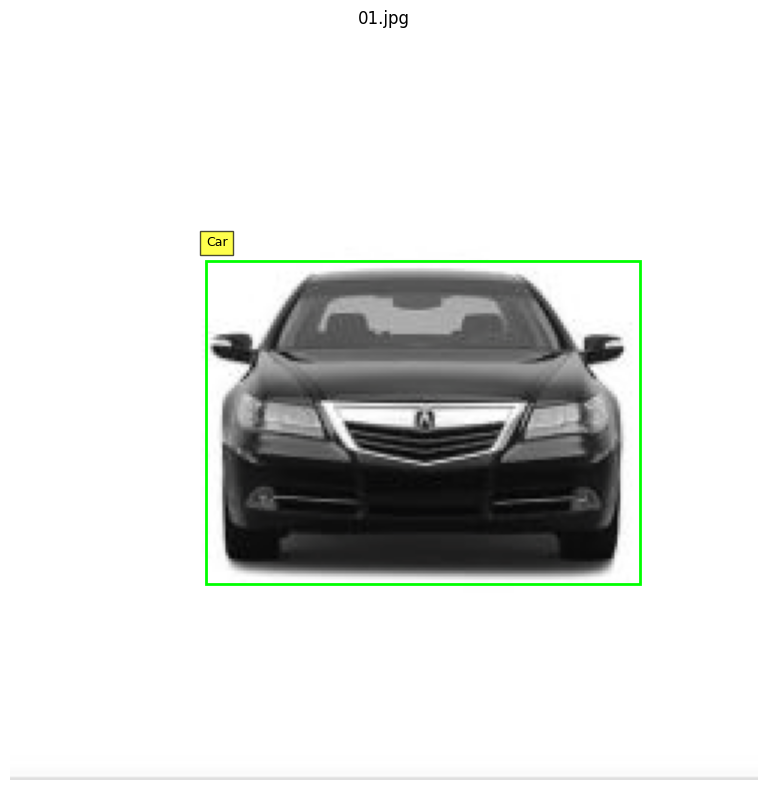

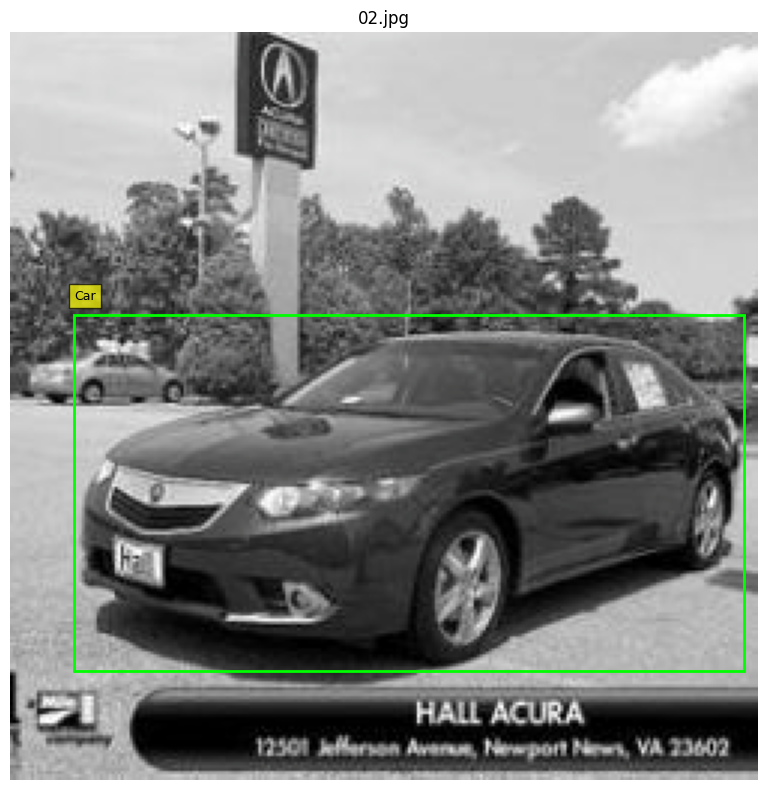

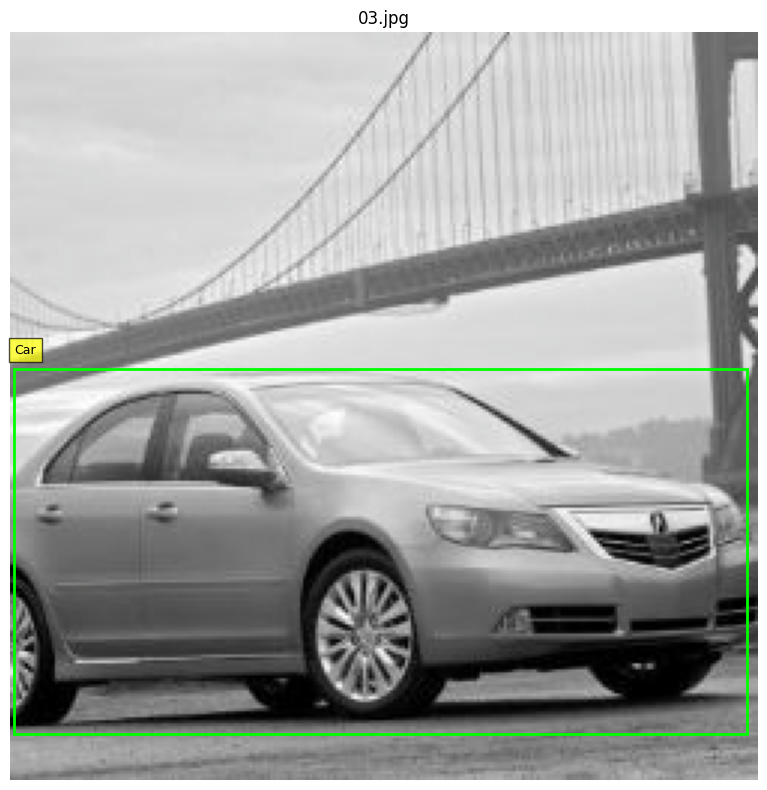

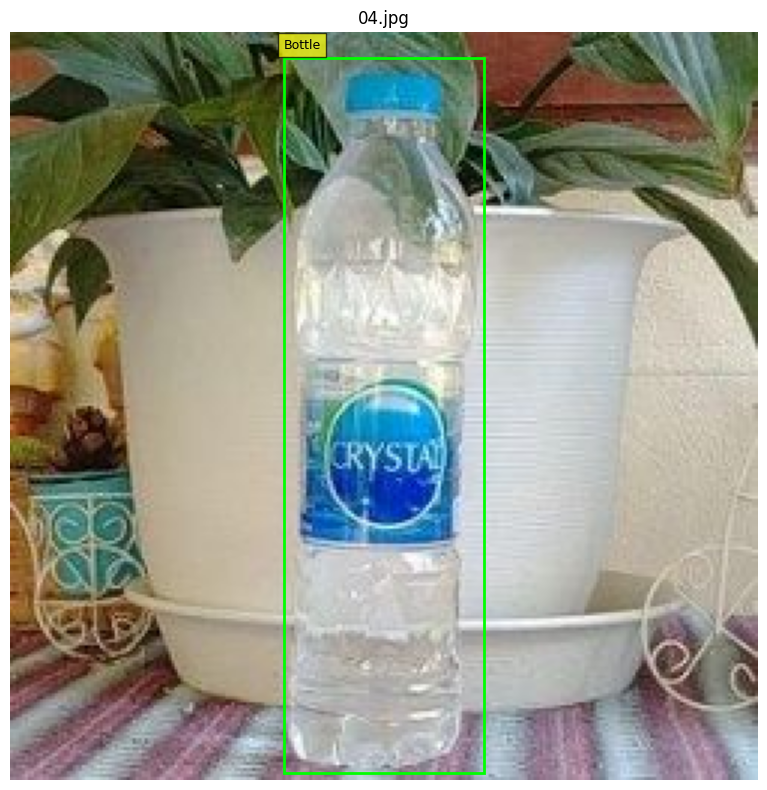

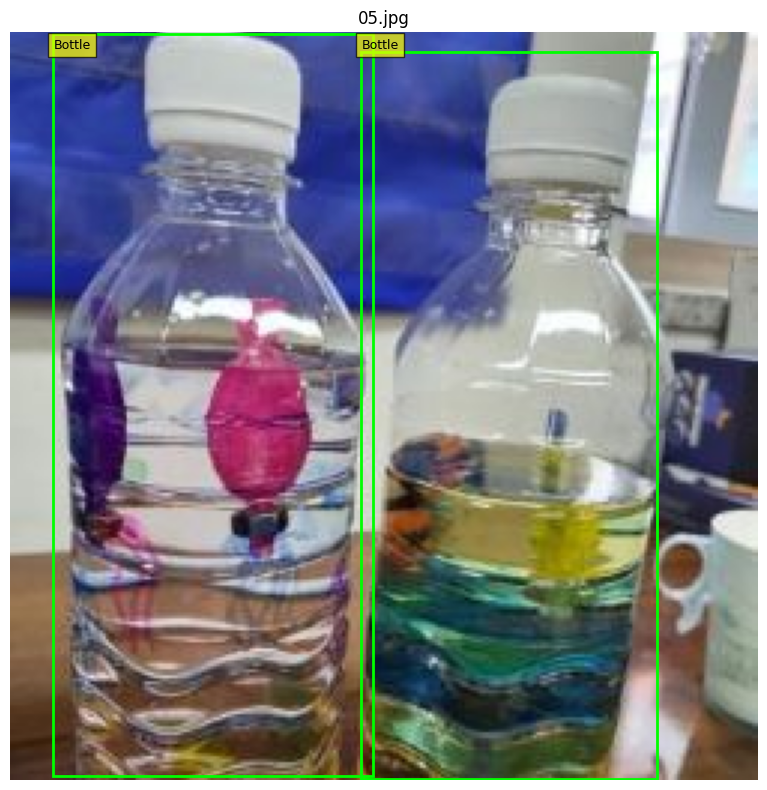

...

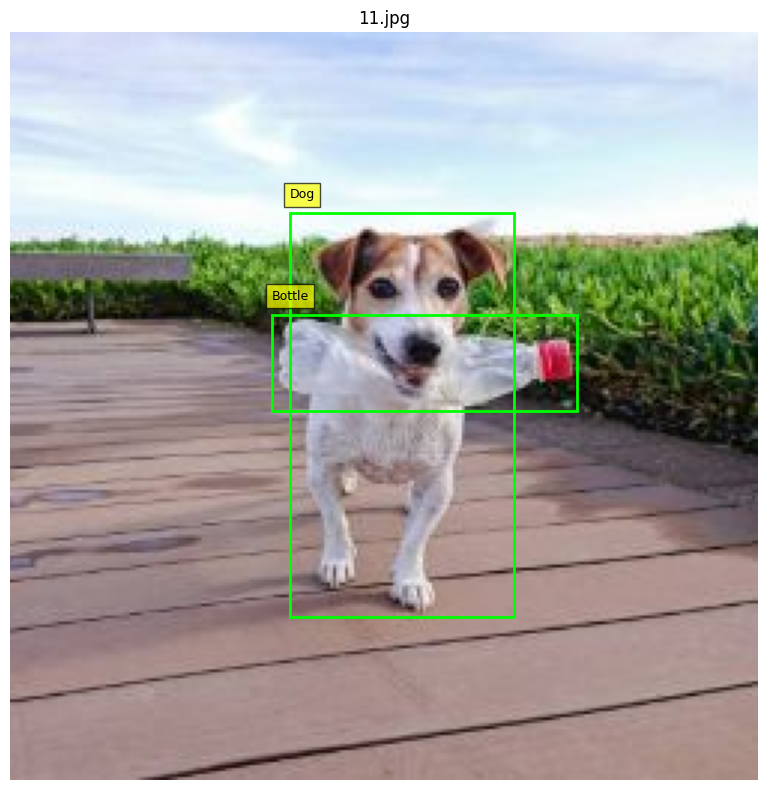

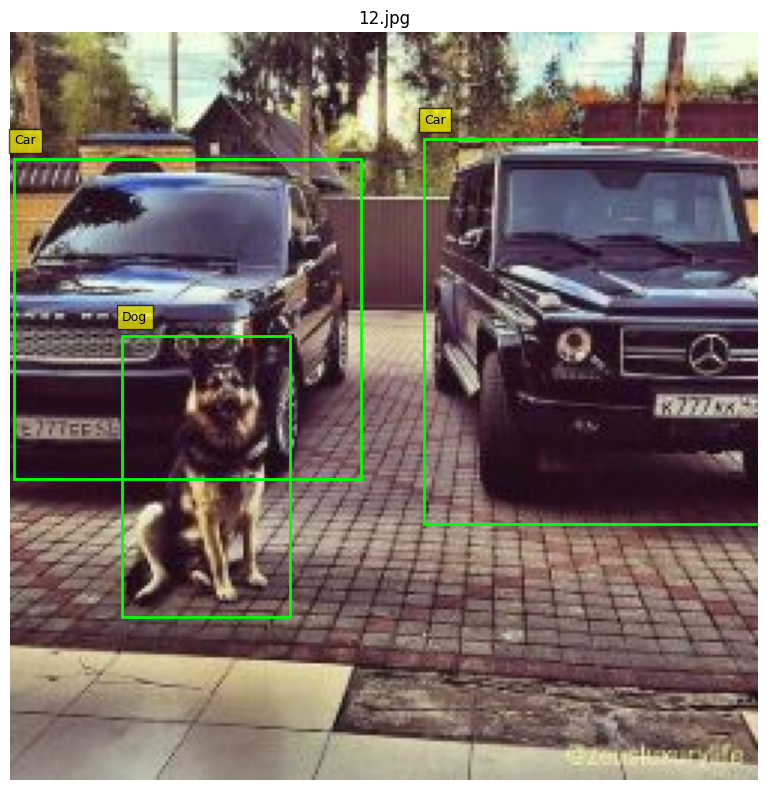

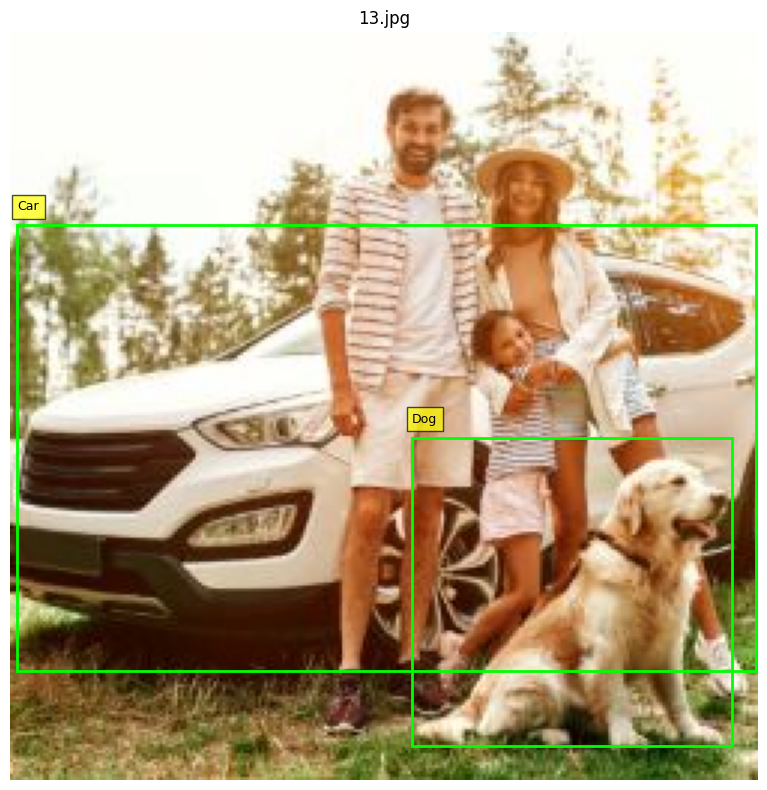

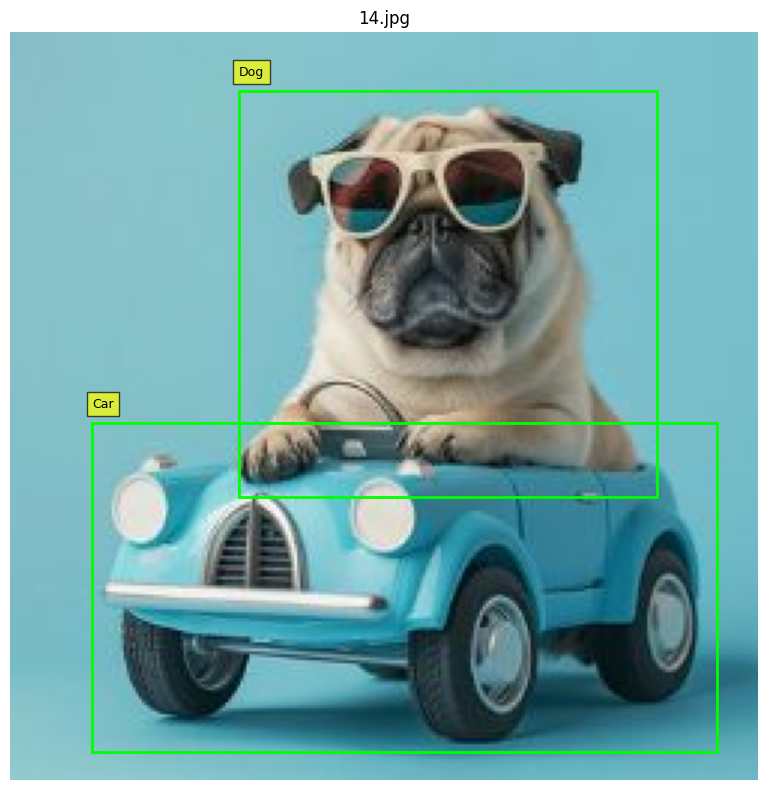

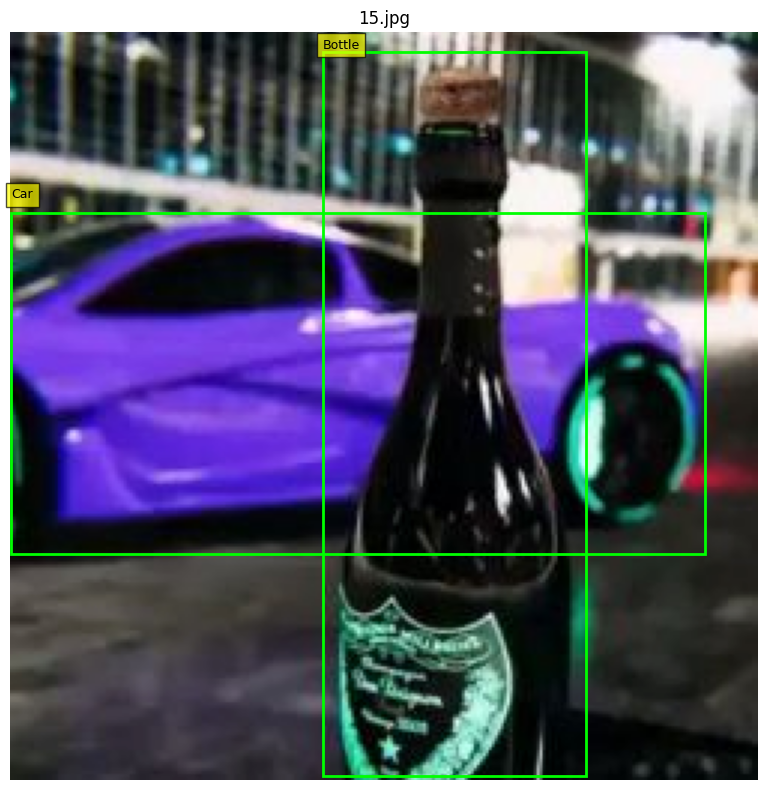

In [81]:
visualize_annotations_from_dataloader_and_save(data_loader, class_map, save_dir="/kaggle/working/annotated_images")

In [15]:
from transformers import AutoProcessor, AutoModelForCausalLM  
from PIL import Image
import requests
import copy
import torch
%matplotlib inline  

model_id = 'microsoft/Florence-2-large'
model = AutoModelForCausalLM.from_pretrained(model_id, trust_remote_code=True, torch_dtype='auto').eval().cuda()
processor = AutoProcessor.from_pretrained(model_id, trust_remote_code=True)

2025-06-12 12:20:17.776944: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749730817.972118      35 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749730818.027439      35 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


config.json:   0%|          | 0.00/2.44k [00:00<?, ?B/s]

configuration_florence2.py:   0%|          | 0.00/15.1k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- configuration_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


modeling_florence2.py:   0%|          | 0.00/127k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- modeling_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.
/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


pytorch_model.bin:   0%|          | 0.00/1.56G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/51.0 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

processing_florence2.py:   0%|          | 0.00/48.7k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- processing_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


tokenizer_config.json:   0%|          | 0.00/34.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.10M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

In [86]:
import os
import torch
from tqdm import tqdm
from torchvision import transforms

# Define this somewhere globally in your script
CLASS_MAP = {"car": 0, "bottle": 1, "dog": 2}  

def run_florence_annotation_on_dataloader(
    model,
    processor,
    dataloader,
    device,
    torch_dtype,
    save_label_dir,
    log_file_path,
    task_prompt="<OD>",
    text_input=None,
):
    os.makedirs(save_label_dir, exist_ok=True)
    os.makedirs(os.path.dirname(log_file_path), exist_ok=True)

    with open(log_file_path, 'w') as log_file:
        for batch_idx, (images, img_names, original_sizes, img_names) in enumerate(
            tqdm(dataloader, desc="Running Florence-2 on DataLoader")
        ):
            for idx in range(images.size(0)):
                image_tensor = images[idx].to(device, torch_dtype)
                orig_w, orig_h = original_sizes[idx]
                img_path = img_names[idx]
                if isinstance(img_path, list):
                    img_path = img_path[0]
                # print(img_path)
                img_base = os.path.splitext(os.path.basename(img_path))[0]
                label_path = os.path.join(save_label_dir, f"{img_base}.txt")

                # Convert tensor to PIL
                mean = torch.tensor([0.565, 0.566, 0.529]).view(3, 1, 1).to(device)
                std = torch.tensor([0.276, 0.276, 0.298]).view(3, 1, 1).to(device)
                image_tensor = image_tensor * std + mean
                image_tensor = torch.clamp(image_tensor, 0, 1)
                image_pil = transforms.ToPILImage()(image_tensor.cpu())

                # Build Florence input
                prompt = task_prompt + (text_input or "")
                inputs = processor(text=prompt, images=image_pil, return_tensors="pt").to(device, torch_dtype)

                # Run Florence-2 generation
                generated_ids = model.generate(
                    input_ids=inputs["input_ids"],
                    pixel_values=inputs["pixel_values"],
                    max_new_tokens=1024,
                    num_beams=3,
                    return_dict_in_generate=True,
                    output_scores=True,
                )

                transition_beam_scores = model.compute_transition_scores(
                    sequences=generated_ids.sequences,
                    scores=generated_ids.scores,
                    beam_indices=generated_ids.beam_indices,
                )

                parsed = processor.post_process_generation(
                    sequence=generated_ids.sequences[0],
                    transition_beam_score=transition_beam_scores[0],
                    task="<OD>",
                    image_size=(orig_w, orig_h)
                )

                od_result = parsed.get("<OD>", {})
                bboxes = od_result.get("bboxes", [])
                labels = od_result.get("labels", [])

                # Save YOLO-format label file
                with open(label_path, 'w') as f:
                    if not bboxes:
                        print(f"[!] No objects found in {img_base}. Skipping.")
                    for i in range(len(bboxes)):
                        label_name = labels[i].lower()
                        cls_id = CLASS_MAP.get(label_name, -1)
                        if cls_id == -1:
                            print(f"[!] Unknown label '{label_name}' in {img_base}. Skipping.")
                            continue

                        x1, y1, x2, y2 = bboxes[i]
                        cx = ((x1 + x2) / 2) / orig_w
                        cy = ((y1 + y2) / 2) / orig_h
                        bw = (x2 - x1) / orig_w
                        bh = (y2 - y1) / orig_h

                        f.write(f"{cls_id} {cx:.6f} {cy:.6f} {bw:.6f} {bh:.6f}\n")

                readable_save_dir = os.path.join(save_label_dir, "..", "detailed_labels")
                os.makedirs(readable_save_dir, exist_ok=True)
                readable_path = os.path.join(readable_save_dir, f"{img_base}.txt")

                with open(readable_path, 'w') as f_readable:
                    if not bboxes:
                        f_readable.write("[!] No objects found.\n")
                    for i in range(len(bboxes)):
                        label_name = labels[i]
                        cls_id = CLASS_MAP.get(label_name.lower(), -1)
                        if cls_id == -1:
                            continue
                        x1, y1, x2, y2 = bboxes[i]
                        score = od_result.get("scores", [0.0] * len(bboxes))[i]
                        # No square brackets, clean and space-separated
                        f_readable.write(f"{cls_id} {label_name} {x1:.2f} {y1:.2f} {x2:.2f} {y2:.2f} {score:.4f}\n")

        
                # Log full parsed output
                # Log parsed output in readable format
                log_file.write(f"Image: {img_base}.jpg\n")
                scores = od_result.get("scores", [])
                for i in range(len(bboxes)):
                    label_name = labels[i]
                    label_lower = label_name.lower()
                    cls_id = CLASS_MAP.get(label_lower, -1)
                    if cls_id == -1:
                        continue
                    bbox = bboxes[i]
                    score = scores[i] if i < len(scores) else 0.0
                    bbox_str = "[" + ", ".join(f"{coord:.2f}" for coord in bbox) + "]"
                    log_file.write(f"{cls_id} {label_name} {bbox_str} {score:.2f}\n")
                log_file.write("\n")



In [91]:
run_florence_annotation_on_dataloader(
    model=model,
    processor=processor,
    dataloader=data_loader,  # Your DataLoader from earlier
    device=device,
    torch_dtype=torch.float16,  # or torch.float32
    save_label_dir="/kaggle/working/generated_labels_2",
    log_file_path="/kaggle/working/florence_output_log_2.txt",
    task_prompt="<CAPTION_TO_PHRASE_GROUNDING>",  # or "<CAPTION_TO_PHRASE_GROUNDING>"
    text_input="dog, car, bottle"  # or None
)


Running Florence-2 on DataLoader: 100%|██████████| 1/1 [00:08<00:00,  8.11s/it]


In [92]:
import os
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def plot_yolo_annotations(image_dir, label_dir, class_map, image_exts={'.jpg', '.png', '.jpeg'}, max_images=None):
    """
    Plot bounding boxes from YOLO-format labels on images.

    Args:
        image_dir (str): Path to folder containing images.
        label_dir (str): Path to folder containing YOLO label files.
        class_map (dict): Class index to name mapping.
        image_exts (set): Valid image extensions.
        max_images (int): Max number of images to visualize (optional).
    """
    image_files = [f for f in sorted(os.listdir(image_dir)) if os.path.splitext(f)[1].lower() in image_exts]
    if max_images:
        image_files = image_files[:max_images]

    for image_file in image_files:
        # Load image
        image_path = os.path.join(image_dir, image_file)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h, w, _ = image.shape

        # Load corresponding label file
        label_file = os.path.splitext(image_file)[0] + ".txt"
        label_path = os.path.join(label_dir, label_file)

        bboxes = []
        labels = []

        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) != 5:
                        continue
                    cls_id, cx, cy, bw, bh = map(float, parts)
                    x1 = int((cx - bw / 2) * w)
                    y1 = int((cy - bh / 2) * h)
                    x2 = int((cx + bw / 2) * w)
                    y2 = int((cy + bh / 2) * h)

                    bboxes.append((x1, y1, x2, y2))
                    labels.append(class_map.get(int(cls_id), str(int(cls_id))))
        
        # Plot
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.imshow(image)
        for bbox, label in zip(bboxes, labels):
            x1, y1, x2, y2 = bbox
            rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                     linewidth=1.5, edgecolor='lime', facecolor='none')
            ax.add_patch(rect)
            ax.text(x1, y1, label, color='black', fontsize=8,
                    bbox=dict(facecolor='yellow', alpha=0.7))
        ax.set_title(image_file)
        ax.axis('off')
        plt.tight_layout()
        plt.show()

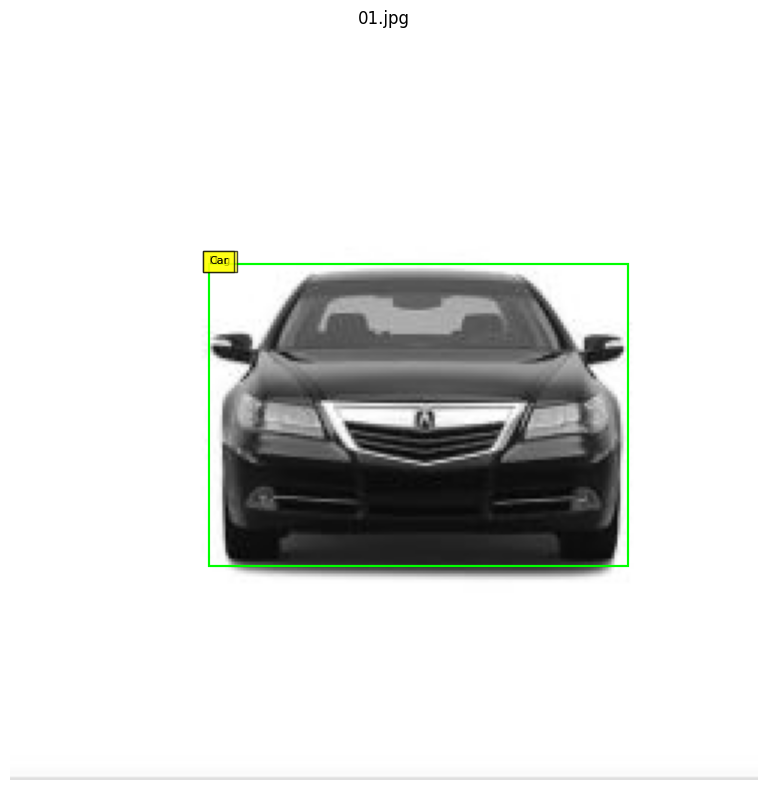

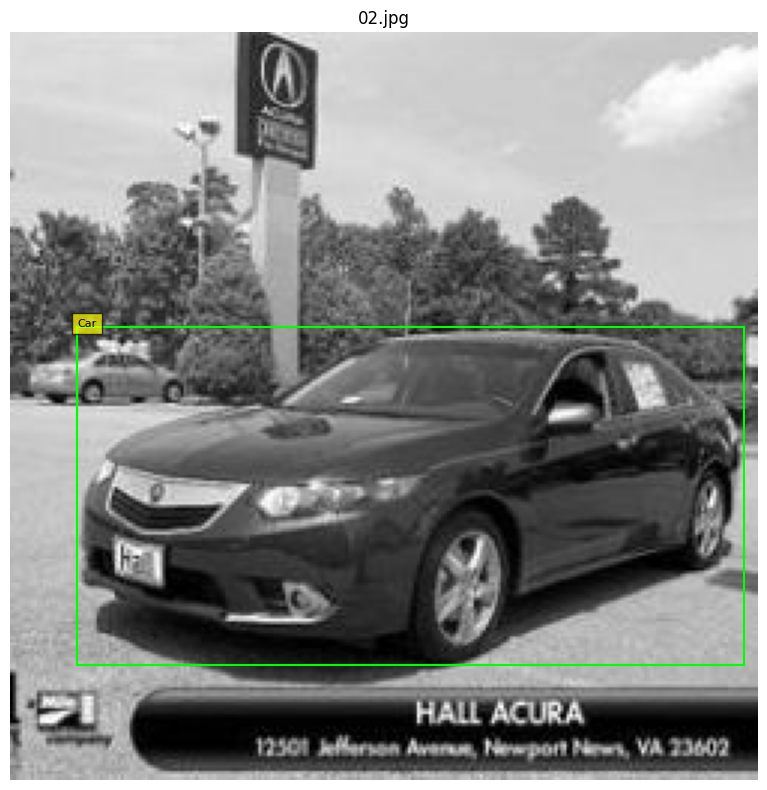

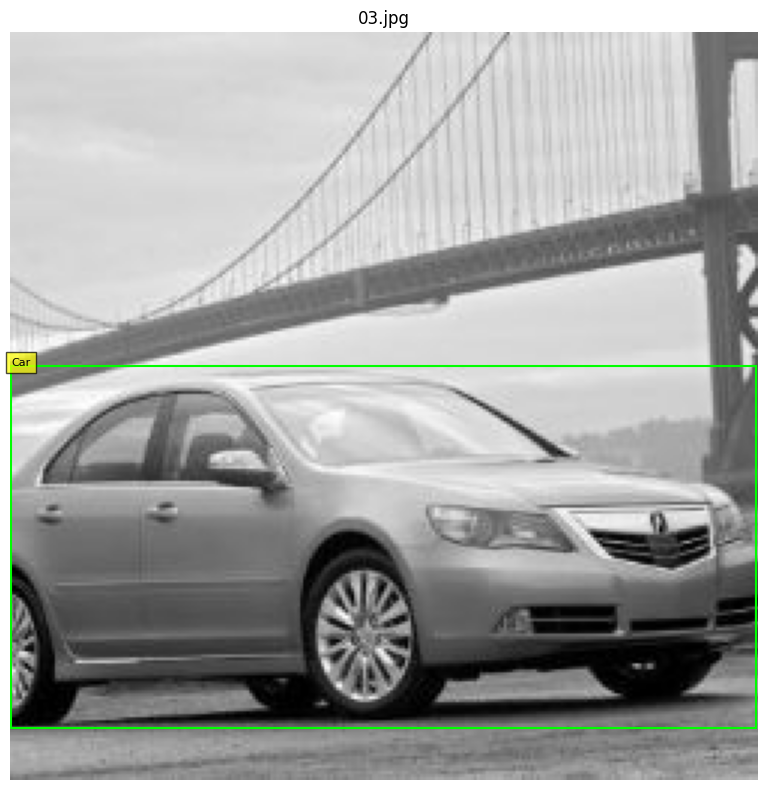

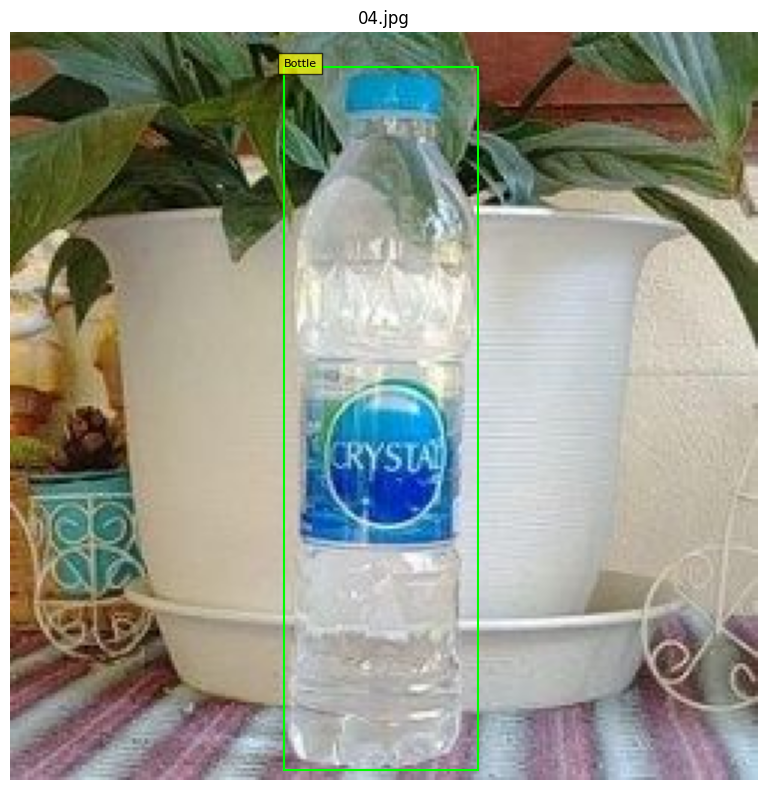

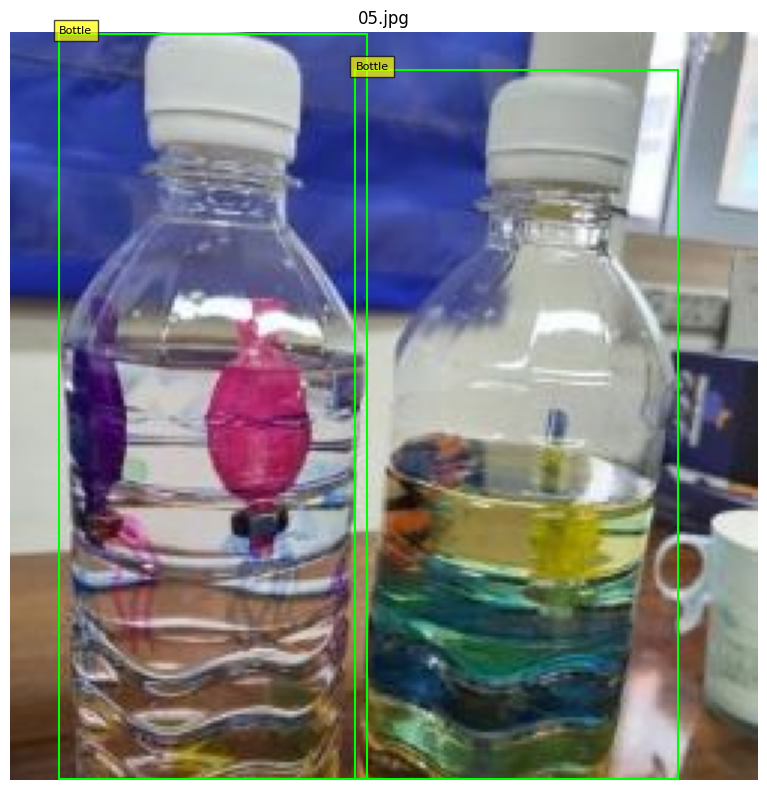

...

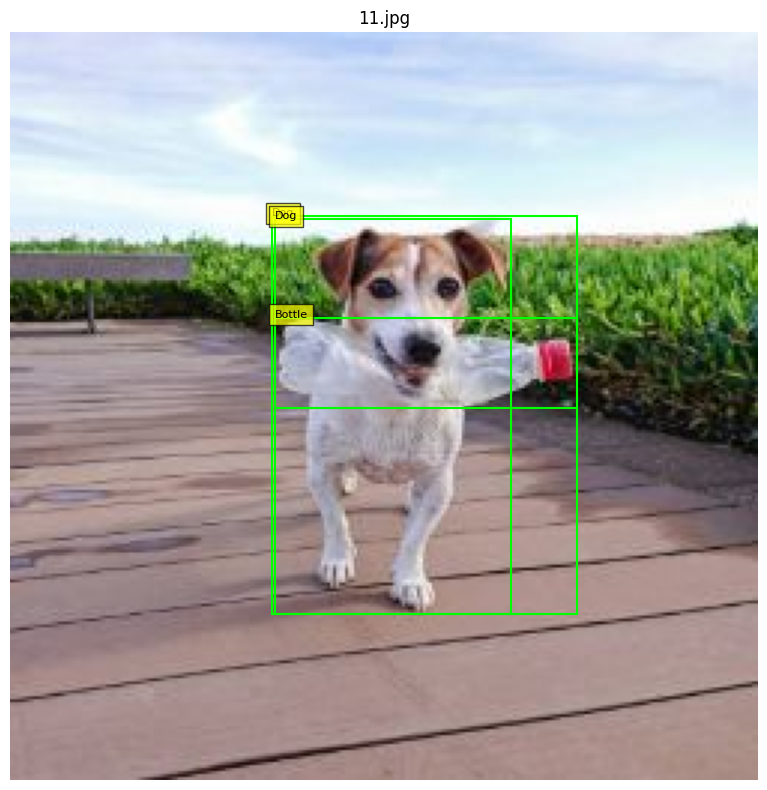

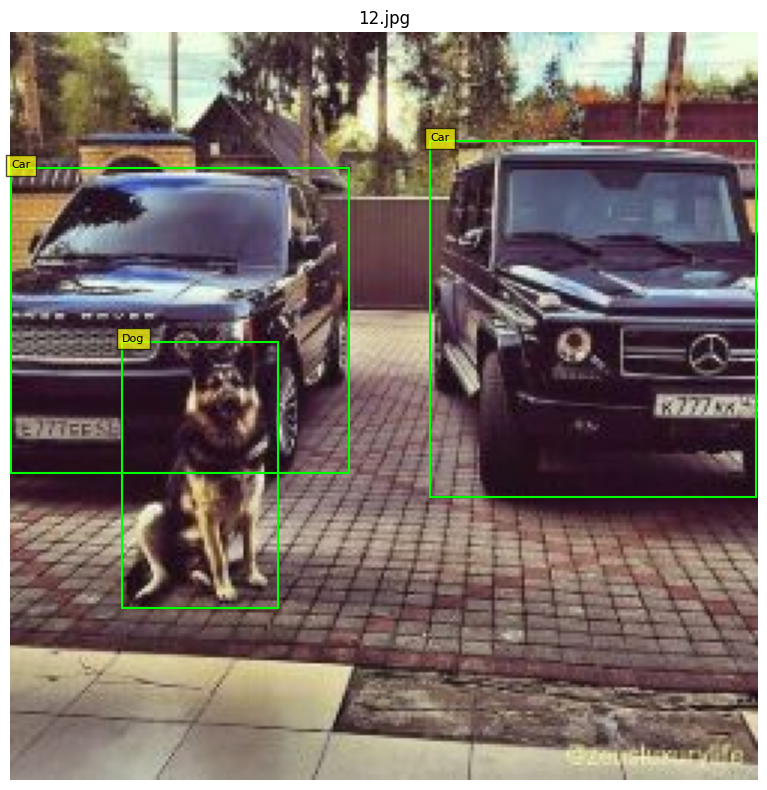

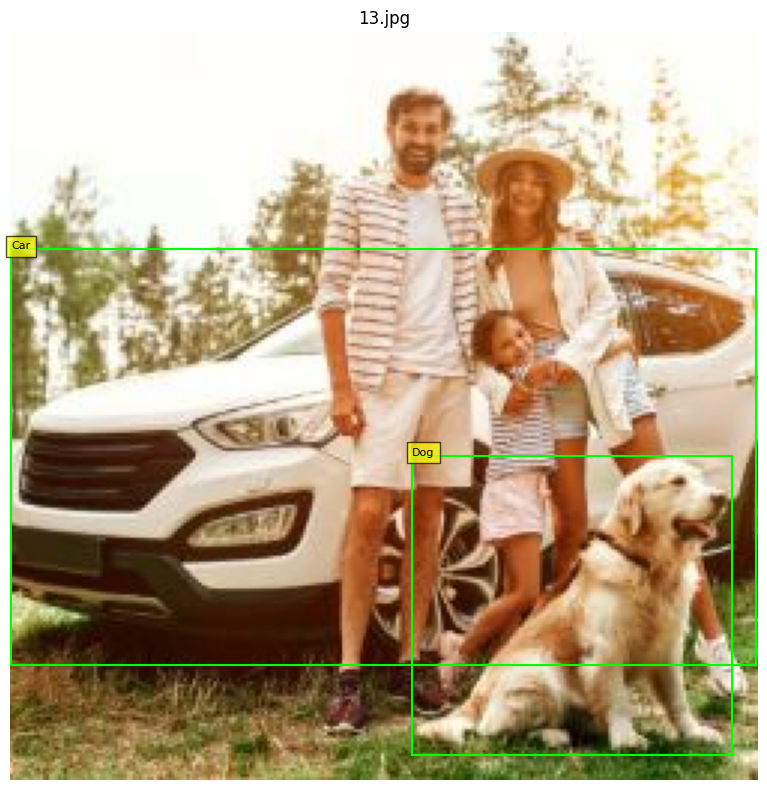

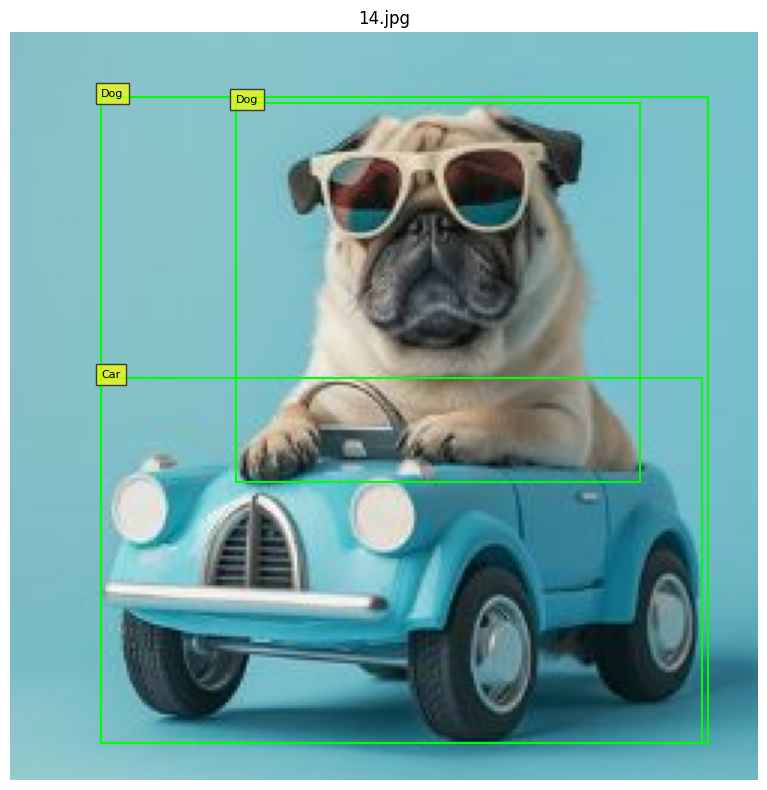

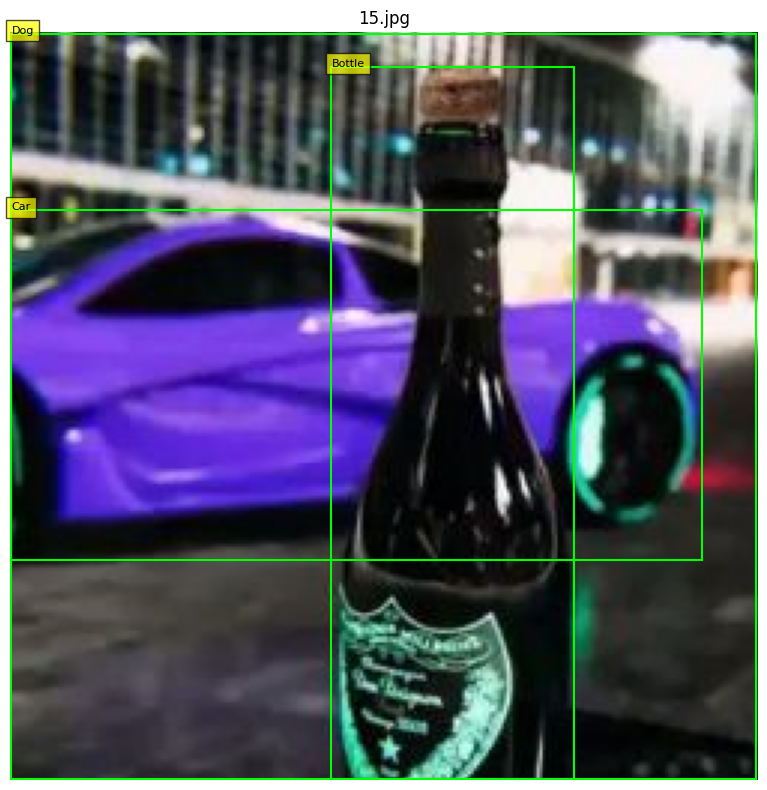

In [93]:
class_map = {
    0: "Car",
    1: "Bottle",
    2: "Dog"
}

plot_yolo_annotations(
    image_dir="/kaggle/input/auto-annotation/Dataset/Images",
    label_dir="/kaggle/working/generated_labels_2",
    class_map=class_map,
)


In [95]:
import os
import numpy as np
from collections import defaultdict
from tqdm import tqdm

# --- Configuration ---
IOU_THRESHOLD = 0.5
NUM_CLASSES = 3 # Make sure this matches your dataset's number of classes

# IMPORTANT: Set your image dimensions here. 
# This is crucial for converting YOLO ground truth coordinates correctly.
DEFAULT_IMAGE_WIDTH = 250 # Replace with your actual image width
DEFAULT_IMAGE_HEIGHT = 250 # Replace with your actual image height

# --- Helper Functions ---

# Function to compute IoU between two bounding boxes [x1, y1, x2, y2]
def compute_iou(box1, box2):
    x1 = max(box1[0], box2[0])
    y1 = max(box1[1], box2[1])
    x2 = min(box1[2], box2[2])
    y2 = min(box1[3], box2[3])

    inter_area = max(0, x2 - x1) * max(0, y2 - y1)
    if inter_area == 0:
        return 0.0
    
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])
    union_area = box1_area + box2_area - inter_area

    return inter_area / union_area

# Convert YOLO normalized (xc, yc, w, h) to absolute (xmin, ymin, xmax, ymax)
def yolo_normalized_to_xyxy(xc_norm, yc_norm, w_norm, h_norm, img_width, img_height):
    xc = xc_norm * img_width
    yc = yc_norm * img_height
    w = w_norm * img_width
    h = h_norm * img_height
    
    xmin = xc - w / 2
    ymin = yc - h / 2
    xmax = xc + w / 2
    ymax = yc + h / 2
    return [xmin, ymin, xmax, ymax]

# Parse label file (handles both YOLO GT and custom prediction format)
def parse_label_file(filepath, is_gt=False, img_width=DEFAULT_IMAGE_WIDTH, img_height=DEFAULT_IMAGE_HEIGHT):
    boxes = []
    if not os.path.exists(filepath):
        return boxes

    with open(filepath, 'r') as f:
        for line in f:
            parts = line.strip().split()
            
            if is_gt:
                # YOLO GT format: class_id xc_norm yc_norm w_norm h_norm
                class_id = int(parts[0])
                # Convert normalized YOLO to absolute XYXY
                bbox_xyxy = yolo_normalized_to_xyxy(
                    float(parts[1]), float(parts[2]), float(parts[3]), float(parts[4]),
                    img_width, img_height
                )
                boxes.append({'class_id': class_id, 'bbox': bbox_xyxy})
            else:
                # Prediction format: class_id class_name x1 y1 x2 y2 confidence_score
                # Note: 'class_name' (parts[1]) is skipped as it's not used in evaluation
                class_id = int(parts[0])
                x1 = float(parts[2])
                y1 = float(parts[3])
                x2 = float(parts[4])
                y2 = float(parts[5])
                confidence = float(parts[6])
                boxes.append({'class_id': class_id, 'bbox': [x1, y1, x2, y2], 'confidence': confidence})
    return boxes

# Function to calculate Average Precision (AP) for a single class
def calculate_ap(detections, num_ground_truths):
    # Sort detections by confidence in descending order
    detections = sorted(detections, key=lambda x: x['confidence'], reverse=True)

    TP = np.zeros(len(detections))
    FP = np.zeros(len(detections))

    for d_idx, detection in enumerate(detections):
        if detection['is_tp']:
            TP[d_idx] = 1
        else:
            FP[d_idx] = 1

    cumulative_TP = np.cumsum(TP)
    cumulative_FP = np.cumsum(FP)

    precision = cumulative_TP / (cumulative_TP + cumulative_FP)
    recall = cumulative_TP / num_ground_truths if num_ground_truths > 0 else np.zeros_like(cumulative_TP)

    # For calculation of AP, we extend the PR curve points
    m_rec = np.concatenate(([0.], recall, [recall[-1] + 1e-6 if len(recall) > 0 else 1.])) # Ensure recall goes to 1
    m_pre = np.concatenate(([0.], precision, [0.])) # Precision at recall=1 is 0

    # Ensure precision is monotonically decreasing (standard for COCO-style AP)
    for i in range(len(m_pre) - 2, -1, -1):
        m_pre[i] = max(m_pre[i], m_pre[i+1])

    # Calculate AP as the area under the PR curve using trapezoidal rule
    ap = np.sum((m_rec[1:] - m_rec[:-1]) * m_pre[1:])
    
    # Return AP and the final precision/recall (corresponding to IOU_THRESHOLD)
    final_precision = precision[-1] if len(precision) > 0 else 0
    final_recall = recall[-1] if len(recall) > 0 else 0
    
    return ap, final_precision, final_recall

# --- Main Evaluation Function ---
def evaluate_metrics(pred_dir, gt_dir, num_classes=NUM_CLASSES, 
                     img_width=DEFAULT_IMAGE_WIDTH, img_height=DEFAULT_IMAGE_HEIGHT):
    
    all_detections_per_class = defaultdict(list) 
    all_ground_truths_per_class = defaultdict(int)

    gt_files = sorted([f for f in os.listdir(gt_dir) if f.endswith(".txt")])
    
    for file in tqdm(gt_files, desc="Processing Images"):
        gt_path = os.path.join(gt_dir, file)
        pred_path = os.path.join(pred_dir, file) # Predictions often have same filename

        # Parse ground truth and prediction boxes for the current image
        gt_boxes = parse_label_file(gt_path, is_gt=True, img_width=img_width, img_height=img_height)
        pred_boxes = parse_label_file(pred_path, is_gt=False) 

        # Keep track of which ground truth boxes have been matched in this image
        gt_matched_in_image = [False] * len(gt_boxes)

        # First, count all ground truths for this image into the global tally
        for gt_box in gt_boxes:
            all_ground_truths_per_class[gt_box['class_id']] += 1

        # Process predictions, ordered by confidence (highest first)
        for pred_box in sorted(pred_boxes, key=lambda x: x['confidence'], reverse=True):
            best_iou = 0
            best_gt_idx = -1

            # Find the best matching ground truth for the current prediction
            for gt_idx, gt_box in enumerate(gt_boxes):
                if gt_box['class_id'] == pred_box['class_id'] and not gt_matched_in_image[gt_idx]:
                    iou = compute_iou(pred_box['bbox'], gt_box['bbox'])
                    if iou > best_iou:
                        best_iou = iou
                        best_gt_idx = gt_idx

            # Determine if the prediction is a True Positive or False Positive
            if best_iou >= IOU_THRESHOLD and best_gt_idx != -1:
                all_detections_per_class[pred_box['class_id']].append({
                    'confidence': pred_box['confidence'],
                    'is_tp': True
                })
                gt_matched_in_image[best_gt_idx] = True # Mark ground truth as matched
            else:
                all_detections_per_class[pred_box['class_id']].append({
                    'confidence': pred_box['confidence'],
                    'is_tp': False
                })

    # --- Calculate Per-Class and Overall Metrics ---
    
    per_class_precision = {}
    per_class_recall = {}
    per_class_f1 = {}
    aps = [] # Average Precisions for each class

    total_tp_overall = 0
    total_fp_overall = 0
    total_fn_overall = 0

    for cls in range(num_classes):
        num_gt_for_class = all_ground_truths_per_class[cls]
        detections_for_class = all_detections_per_class[cls]
        
        # Calculate AP for the current class
        if num_gt_for_class > 0 or len(detections_for_class) > 0:
            ap_val, final_prec, final_rec = calculate_ap(detections_for_class, num_gt_for_class)
            aps.append(ap_val)
        else:
            # If no GT or predictions for a class, AP is 0, and other metrics are 0
            ap_val, final_prec, final_rec = 0.0, 0.0, 0.0
            aps.append(0.0)

        # Store per-class metrics at the IOU_THRESHOLD (from the end of PR curve)
        per_class_precision[cls] = final_prec
        per_class_recall[cls] = final_rec
        per_class_f1[cls] = (2 * final_prec * final_rec) / (final_prec + final_rec) if (final_prec + final_rec) > 0 else 0

        # Accumulate for overall metrics at IOU_THRESHOLD
        class_tps = sum(1 for d in detections_for_class if d['is_tp'])
        class_fps = sum(1 for d in detections_for_class if not d['is_tp'])
        class_fns = num_gt_for_class - class_tps # Number of ground truths not matched

        total_tp_overall += class_tps
        total_fp_overall += class_fps
        total_fn_overall += class_fns
        

    # Calculate Mean Average Precision (mAP)
    mean_ap = sum(aps) / num_classes if num_classes > 0 else 0.0

    # Calculate overall metrics
    overall_precision = total_tp_overall / (total_tp_overall + total_fp_overall) if (total_tp_overall + total_fp_overall) > 0 else 0
    overall_recall = total_tp_overall / (total_tp_overall + total_fn_overall) if (total_tp_overall + total_fn_overall) > 0 else 0
    overall_f1 = (2 * overall_precision * overall_recall) / (overall_precision + overall_recall) if (overall_precision + overall_recall) > 0 else 0
    overall_accuracy = total_tp_overall / (total_tp_overall + total_fp_overall + total_fn_overall) if (total_tp_overall + total_fp_overall + total_fn_overall) > 0 else 0


    return (per_class_precision, per_class_recall, per_class_f1, 
            overall_precision, overall_recall, overall_f1, overall_accuracy, mean_ap)

# --- Example Usage ---
# Make sure these directories exist and contain your label files
pred_dir = "/kaggle/working/detailed_labels" # Your prediction labels
gt_dir = "/kaggle/input/auto-annotation/Dataset/Labels" # Your ground truth labels

# Call the evaluation function
per_class_prec, per_class_rec, per_class_f1, \
overall_prec, overall_rec, overall_f1, overall_acc, mAP = \
evaluate_metrics(pred_dir, gt_dir, NUM_CLASSES, DEFAULT_IMAGE_WIDTH, DEFAULT_IMAGE_HEIGHT)

# --- Print Results ---
print("\n--- Per-Class Metrics (at IoU=0.5) ---")
for cls in range(NUM_CLASSES):
    print(f"Class {cls}: Precision={per_class_prec[cls]:.3f}, Recall={per_class_rec[cls]:.3f}, F1-Score={per_class_f1[cls]:.3f}")

print("\n--- Overall Metrics (aggregated at IoU=0.5) ---")
print(f"Overall Precision: {overall_prec:.3f}")
print(f"Overall Recall: {overall_rec:.3f}")
print(f"Overall F1-Score: {overall_f1:.3f}")
print(f"Overall Accuracy (TP/(TP+FP+FN)): {overall_acc:.3f}")

print(f"\nMean Average Precision (mAP@0.5): {mAP:.3f}")

Processing Images: 100%|██████████| 15/15 [00:00<00:00, 1440.58it/s]


--- Per-Class Metrics (at IoU=0.5) ---
Class 0: Precision=1.000, Recall=1.000, F1-Score=1.000
Class 1: Precision=1.000, Recall=1.000, F1-Score=1.000
Class 2: Precision=0.600, Recall=1.000, F1-Score=0.750

--- Overall Metrics (aggregated at IoU=0.5) ---
Overall Precision: 0.800
Overall Recall: 1.000
Overall F1-Score: 0.889
Overall Accuracy (TP/(TP+FP+FN)): 0.800

Mean Average Precision (mAP@0.5): 0.881


Fine tuning the model

In [1]:
import os
import json

annotations_dir = "/kaggle/input/train-data/train/labels"
output_json_file = "/kaggle/working/train_labels.json"


# annotations_dir = "custom_dataset/instruments_yolov8/valid/labels"
# output_json_file = "custom_dataset/instruments_yolov8/valid/images/val_annotations.json"


def parse_yolo_annotation(annotation_file):
    with open(annotation_file, 'r') as f:
        lines = f.readlines()
   
    image_name = os.path.basename(annotation_file).replace('.txt', '.jpg')
    prefix = "<CAPTION_TO_PHRASE_GROUNDING>"
    suffix_lines = []
   
    for line in lines:
        parts = line.strip().split()
        class_name = parts[0]
        x_center = float(parts[1])
        y_center = float(parts[2])
        width = float(parts[3])
        height = float(parts[4])
       
        x1 = int((x_center - width/2) * 1000)
        y1 = int((y_center - height/2) * 1000)
        x2 = int((x_center + width/2) * 1000)
        y2 = int((y_center + height/2) * 1000)
       
        # Replace '0' with 'face' in the class name if it equals '0'
        if class_name == '0':
            class_name = 'car'
        elif class_name == '1':
            class_name = 'bottle'
        elif class_name == '2':
            class_name = 'dog'                       
        suffix_line = f"{class_name}<loc_{x1}><loc_{y1}><loc_{x2}><loc_{y2}>"
        suffix_lines.append(suffix_line)
   
    json_obj = {
        "image": image_name,
        "prefix": prefix,
        "suffix": "".join(suffix_lines)
    }
   
    return json_obj

annotations_json_strings = []

for filename in os.listdir(annotations_dir):
    if filename.endswith(".txt"):
        annotation_file = os.path.join(annotations_dir, filename)
        annotation_obj = parse_yolo_annotation(annotation_file)
        json_string = json.dumps(annotation_obj, separators=(',', ':'))
        annotations_json_strings.append(json_string)

with open(output_json_file, 'w') as json_file:
    json_file.write("\n".join(annotations_json_strings))

print(f"Annotations have been written to {output_json_file}")

Annotations have been written to /kaggle/working/train_labels.json


In [2]:
import io
import os
import re
import json
import torch
import html
import base64
import itertools

import numpy as np
from IPython.core.display import display, HTML
from torch.utils.data import Dataset, DataLoader
from torch.optim import Adam  
from transformers import (
    AutoModelForCausalLM,
    AutoProcessor,
    get_scheduler
)
from tqdm import tqdm
from typing import List, Dict, Any, Tuple, Generator
from peft import LoraConfig, get_peft_model
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image, ImageDraw, ImageFont


2025-06-12 17:21:24.217468: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749748884.402963      35 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749748884.458205      35 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
import torch
from transformers import AutoModelForCausalLM

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model_id = 'microsoft/Florence-2-large'
#model_id = 'microsoft/Florence-2-base'


# Load model onto the determined device
model = AutoModelForCausalLM.from_pretrained(model_id, trust_remote_code=True).to(DEVICE)

processor = AutoProcessor.from_pretrained(model_id, trust_remote_code=True)

config.json:   0%|          | 0.00/2.44k [00:00<?, ?B/s]

configuration_florence2.py:   0%|          | 0.00/15.1k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- configuration_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


modeling_florence2.py:   0%|          | 0.00/127k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- modeling_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.
/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


pytorch_model.bin:   0%|          | 0.00/1.56G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/51.0 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

processing_florence2.py:   0%|          | 0.00/48.7k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- processing_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


tokenizer_config.json:   0%|          | 0.00/34.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.10M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

In [3]:
class JSONLDataset:
    def __init__(self, jsonl_file_path: str, image_directory_path: str):
        self.jsonl_file_path = jsonl_file_path
        self.image_directory_path = image_directory_path
        self.entries = self._load_entries()

    def _load_entries(self) -> List[Dict[str, Any]]:
        entries = []
        with open(self.jsonl_file_path, 'r') as file:
            for line in file:
                data = json.loads(line)
                entries.append(data)
        return entries

    def __len__(self) -> int:
        return len(self.entries)

    def __getitem__(self, idx: int) -> Tuple[Image.Image, Dict[str, Any]]:
        if idx < 0 or idx >= len(self.entries):
            raise IndexError("Index out of range")

        entry = self.entries[idx]
        image_path = os.path.join(self.image_directory_path, entry['image'])
        try:
            image = Image.open(image_path)
            return (image, entry)
        except FileNotFoundError:
            raise FileNotFoundError(f"Image file {image_path} not found.")


class DetectionDataset(Dataset):
    def __init__(self, jsonl_file_path: str, image_directory_path: str):
        self.dataset = JSONLDataset(jsonl_file_path, image_directory_path)

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        image, data = self.dataset[idx]
        prefix = data['prefix']
        suffix = data['suffix']
        return prefix, suffix, image

In [4]:
# Initiate DetectionsDataset and DataLoader for train and validation subsets
BATCH_SIZE = 2
NUM_WORKERS = 0

def collate_fn(batch):
    questions, answers, images = zip(*batch)
    inputs = processor(text=list(questions), images=list(images), return_tensors="pt", padding=True).to(DEVICE)
    return inputs, answers

train_dataset = DetectionDataset(
    jsonl_file_path = "/kaggle/input/train-data/train_labels.json",
    image_directory_path = "/kaggle/input/train-data/train/train/images"
)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, collate_fn=collate_fn, num_workers=NUM_WORKERS, shuffle=True)

In [5]:
config = LoraConfig(
    r=8,
    lora_alpha=8,
    target_modules=["q_proj", "o_proj", "k_proj", "v_proj", "linear", "Conv2d", "lm_head", "fc2"],
    task_type="CAUSAL_LM",
    lora_dropout=0.05,
    bias="none",
    inference_mode=False,
    use_rslora=True,
    init_lora_weights="gaussian",
)

peft_model = get_peft_model(model, config)
peft_model.print_trainable_parameters()

trainable params: 4,133,576 || all params: 833,118,920 || trainable%: 0.4962


In [21]:
torch.cuda.empty_cache()

In [6]:
from torch.optim import AdamW
from transformers import get_scheduler

def train_model(train_loader, model, processor, epochs=10, lr=1e-6):
    optimizer = AdamW(model.parameters(), lr=lr)
    num_training_steps = epochs * len(train_loader)
    lr_scheduler = get_scheduler(
        name="linear",
        optimizer=optimizer,
        num_warmup_steps=0,
        num_training_steps=num_training_steps,
    )

    for epoch in range(epochs):
        model.train()
        train_loss = 0
        for inputs, answers in tqdm(train_loader, desc=f"Training Epoch {epoch + 1}/{epochs}"):

            input_ids = inputs["input_ids"]
            pixel_values = inputs["pixel_values"]
            labels = processor.tokenizer(
                text=answers,
                return_tensors="pt",
                padding=True,
                return_token_type_ids=False
            ).input_ids.to(DEVICE)

            outputs = model(input_ids=input_ids, pixel_values=pixel_values, labels=labels)
            loss = outputs.loss

            loss.backward()
            optimizer.step()
            lr_scheduler.step()
            optimizer.zero_grad()
            train_loss += loss.item()

        avg_train_loss = train_loss / len(train_loader)
        print(f"Average Training Loss: {avg_train_loss}")

        # Save model checkpoint
        output_dir = f"./model_checkpoints/epoch_{epoch+1}"
        os.makedirs(output_dir, exist_ok=True)
        model.save_pretrained(output_dir)
        processor.save_pretrained(output_dir)


In [7]:

EPOCHS = 10
LR = 4e-6
train_model(train_loader, peft_model, processor, epochs=EPOCHS, lr=LR)

Training Epoch 1/10: 100%|██████████| 15/15 [00:44<00:00,  2.98s/it]
/usr/local/lib/python3.11/dist-packages/peft/utils/save_and_load.py:230: UserWarning: Setting `save_embedding_layers` to `True` as embedding layers found in `target_modules`.
  warnings.warn("Setting `save_embedding_layers` to `True` as embedding layers found in `target_modules`.")


Average Training Loss: 7.1649267196655275


Training Epoch 2/10: 100%|██████████| 15/15 [00:43<00:00,  2.89s/it]


Average Training Loss: 7.320358467102051


Training Epoch 3/10: 100%|██████████| 15/15 [00:43<00:00,  2.89s/it]


Average Training Loss: 6.552149931589763


Training Epoch 4/10: 100%|██████████| 15/15 [00:43<00:00,  2.89s/it]


Average Training Loss: 6.301970990498861


Training Epoch 5/10: 100%|██████████| 15/15 [00:43<00:00,  2.88s/it]


Average Training Loss: 6.295479583740234


Training Epoch 6/10: 100%|██████████| 15/15 [00:43<00:00,  2.89s/it]


Average Training Loss: 6.117961279551188


Training Epoch 7/10: 100%|██████████| 15/15 [00:43<00:00,  2.89s/it]


Average Training Loss: 5.9399360656738285


Training Epoch 8/10: 100%|██████████| 15/15 [00:43<00:00,  2.89s/it]


Average Training Loss: 6.042562007904053


Training Epoch 9/10: 100%|██████████| 15/15 [00:43<00:00,  2.89s/it]


Average Training Loss: 6.08437245686849


Training Epoch 10/10: 100%|██████████| 15/15 [00:43<00:00,  2.89s/it]


Average Training Loss: 5.957528972625733


In [ ]:
!zip -r file.zip /kaggle/working
!ls
from IPython.display import FileLink
FileLink(r'file.zip')

In [3]:
# Test custom model 
test_image = '/kaggle/input/auto-annotation/Dataset/Images/04.jpg'
image = Image.open(test_image)

model_id = '/kaggle/input/model-checkpoints/kaggle/working/model_checkpoints/epoch_10'
model = AutoModelForCausalLM.from_pretrained(model_id,
                                             trust_remote_code=True).eval()
processor = AutoProcessor.from_pretrained(model_id, trust_remote_code=True)


def florence2(task_prompt, images, text_input=None):
    """
    Calling the Microsoft Florence2 model
    """
    if text_input is None:
        prompt = task_prompt
    else:
        prompt = task_prompt + text_input

    inputs = processor(text=prompt, images=image, return_tensors="pt")

    generated_ids = model.generate(
        input_ids=inputs["input_ids"],
        pixel_values=inputs["pixel_values"],
        max_new_tokens=1024,
        early_stopping=False,
        do_sample=False,
        num_beams=3,
    )
    generated_text = processor.batch_decode(generated_ids,
                                            skip_special_tokens=False)[0]
    parsed_answer = processor.post_process_generation(
        generated_text,
        task=task_prompt,
        image_size=(image.width, image.height))

    return parsed_answer

config.json:   0%|          | 0.00/2.44k [00:00<?, ?B/s]

configuration_florence2.py:   0%|          | 0.00/15.1k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- configuration_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


modeling_florence2.py:   0%|          | 0.00/127k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- modeling_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.
/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


pytorch_model.bin:   0%|          | 0.00/1.56G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/51.0 [00:00<?, ?B/s]

processing_florence2.py:   0%|          | 0.00/48.7k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- processing_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


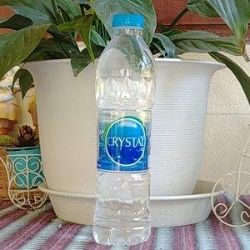

In [4]:
image

In [5]:
task_prompt3 = '<CAPTION_TO_PHRASE_GROUNDING>'
od_results = florence2(task_prompt3, image, text_input="bottle")  
od_results['<CAPTION_TO_PHRASE_GROUNDING>']

{'bboxes': [[91.875, 11.625, 156.375, 246.125]], 'labels': ['bottle']}

In [6]:
def plot_bbox(image, data):
    fig, ax = plt.subplots()

    # Display the image
    ax.imshow(image)

    # Plot each bounding box
    for bbox, label in zip(data['bboxes'], data['labels']):
        # Unpack the bounding box coordinates
        x1, y1, x2, y2 = bbox
        # Create a Rectangle patch
        rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1, edgecolor='r', facecolor='none')
        # Add the rectangle to the Axes
        ax.add_patch(rect)
        # Annotate the label
        plt.text(x1, y1, label, color='white', fontsize=8, bbox=dict(facecolor='red', alpha=0.5))

    # Remove the axis ticks and labels
    ax.axis('off')

    # Show the plot
    plt.show()



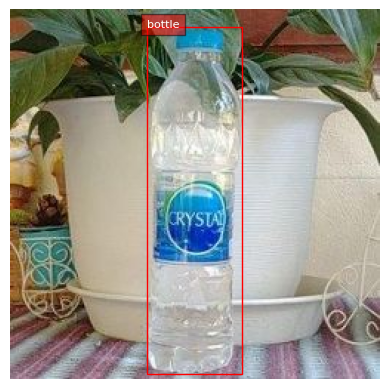

In [8]:
plot_bbox(image, od_results['<CAPTION_TO_PHRASE_GROUNDING>']);

In [14]:
import os
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import numpy as np
from tqdm import tqdm # Import tqdm for progress bar

# print("--- Checking for CUDA availability ---")
# if torch.cuda.is_available():
#     device = torch.device("cuda")
#     print(f"CUDA is available! Using GPU: {torch.cuda.get_device_name(0)}")
# else:
#     device = torch.device("cpu")
#     print("CUDA is NOT available. Using CPU.")
# print("------------------------------------\n")

device = torch.device("cpu")

# --- 1. Define the transform pipeline ---
transform_pipeline = transforms.Compose([
    transforms.Resize((250, 250)),
    transforms.ToTensor(),         
    transforms.Normalize([0.565, 0.566, 0.529], 
                         [0.276, 0.276, 0.298])
])

# --- 2. Define the Custom Dataset Class ---
class ImageAnnotationDataset(Dataset):
    def __init__(self, image_dir, label_dir=None, transform=None):
        """
        Initializes the custom dataset.

        Args:
            image_dir (string): Path to the directory containing image files.
            label_dir (string, optional): Path to the directory containing YOLO format label files (.txt).
                                          If None, no labels will be loaded for evaluation.
            transform (callable, optional): Optional transform to be applied to the images.
        """
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.transform = transform
        
        # Collect all image filenames, ensuring common image extensions are included.
        # Files are sorted for consistent ordering.
        self.image_files = sorted([f for f in os.listdir(image_dir) 
                                   if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp'))])
        
        if not self.image_files:
            print(f"Warning: No image files found in {image_dir}. Please check your path and file extensions.")
            
        print(f"Dataset initialized with {len(self.image_files)} images.")
        if self.label_dir:
            print(f"Label directory provided: {self.label_dir}")
        else:
            print("No label directory provided. Annotations will not be loaded from files.")


    def __len__(self):
        """
        Returns the total number of images in the dataset.
        """
        return len(self.image_files)

    def __getitem__(self, idx):
        """
        Retrieves an item (image, annotations, original size) from the dataset at the given index.

        Args:
            idx (int): Index of the item to retrieve.

        Returns:
            tuple: A tuple containing:
                - transformed_image (torch.Tensor): The image after applying transformations.
                - annotations (list of dicts): A list of dictionaries, where each dictionary
                                              represents an object and contains its 'class_id'
                                              and 'bbox_normalized_xyxy' (xmin, ymin, xmax, ymax).
                                              This will be an empty list if labels are not provided/found.
                - original_size (tuple): The original (width, height) of the image before transforms.
        """
        # Construct the full path to the image
        img_name = self.image_files[idx]
        img_path = os.path.join(self.image_dir, img_name)
        
        # Load the image using PIL and convert to RGB (important for consistent channel order)
        image = Image.open(img_path).convert("RGB")
        original_width, original_height = image.size # Store original dimensions

        # Initialize annotations as an empty list; populate if labels are available
        annotations = []
        if self.label_dir: # Check if a label directory was provided
            # Construct the full path to the corresponding YOLO label file.
            # Assumes label files have the same base name as images but with a .txt extension.
            label_name = img_name.rsplit('.', 1)[0] + '.txt'
            label_path = os.path.join(self.label_dir, label_name)

            if os.path.exists(label_path):
                with open(label_path, 'r') as f:
                    for line in f:
                        parts = list(map(float, line.strip().split()))
                        class_id = int(parts[0])
                        # YOLO format: class_id x_center y_center width height (all normalized 0-1)
                        cx, cy, w, h = parts[1:]

                        # Convert normalized cx, cy, w, h to normalized xmin, ymin, xmax, ymax
                        xmin = cx - (w / 2)
                        ymin = cy - (h / 2)
                        xmax = cx + (w / 2)
                        ymax = cy + (h / 2)
                        
                        # Store the parsed annotation
                        annotations.append({
                            'class_id': class_id,
                            'bbox_normalized_xyxy': [xmin, ymin, xmax, ymax]
                        })


        # Apply transformations to the image if a transform pipeline is provided
        if self.transform:
            transformed_image = self.transform(image)
        else:
            # If no transform is given, convert the PIL Image to a PyTorch Tensor
            transformed_image = transforms.ToTensor()(image)

        # Return the transformed image, the parsed annotations, and the original image size.
        # The original image size is crucial for later converting normalized bounding boxes back to pixel coordinates.
        return transformed_image, annotations, (original_width, original_height), img_name


# --- Custom Collate Function for DataLoader ---
def custom_collate_fn(batch):
    """
    Collate function for DataLoader to handle variable-length annotations.
    It stacks images into a tensor and keeps annotations and original sizes
    as lists of their respective items.
    """
    # Each item in 'batch' is (transformed_image, annotations, original_size)
    
    # Stack the images into a single tensor
    # torch.stack will combine (C, H, W) tensors into (B, C, H, W)
    images = torch.stack([item[0] for item in batch])
    
    # Collect annotations and original sizes as lists
    # These are lists of lists/tuples, maintaining their individual structure per image
    annotations = [item[1] for item in batch]
    original_sizes = [item[2] for item in batch]
    img_names = [item[3] for item in batch]
    
    return images, annotations, original_sizes, img_names


# --- Main Running Part ---
KAGGLE_DATASET_NAME = 'auto-annotation/Dataset' 

# Define the expected paths within the Kaggle environment
KAGGLE_DATASET_ROOT = os.path.join('/kaggle/input', KAGGLE_DATASET_NAME)
KAGGLE_IMAGE_DIR = os.path.join(KAGGLE_DATASET_ROOT, 'Images')

KAGGLE_LABEL_DIR = os.path.join(KAGGLE_DATASET_ROOT, 'Labels')


print("\n--- Initializing and Preparing Dataset ---")
try:
    # Initialize the dataset with your image and label directories
    dataset_for_annotation = ImageAnnotationDataset(
        image_dir=KAGGLE_IMAGE_DIR, 
        label_dir=KAGGLE_LABEL_DIR, # Set to None if no labels are available
        transform=transform_pipeline
    )

    if len(dataset_for_annotation) > 0:
        # Create a DataLoader to batch your images for efficient processing.
        # Set batch_size to the number of images in your dataset to process all in one batch.
        batch_size = len(dataset_for_annotation) 
        
        data_loader = DataLoader(
            dataset_for_annotation, 
            batch_size=batch_size, 
            shuffle=False, 
            num_workers=0,
            collate_fn=custom_collate_fn 
        )

        print(f"\nDataLoader created with batch size: {batch_size}")
        print(f"Total batches to process: {len(data_loader)}")

        # List to hold processed data from the DataLoader
        all_processed_data = []

        print("\n--- Preprocessing images... ---")
        # Loop through the DataLoader with tqdm to show preprocessing progress
        # Since batch_size is len(dataset), there will only be one iteration in the tqdm loop.
        for i, (images, annotations, original_sizes, img_names) in enumerate(tqdm(data_loader, desc="Preprocessing Images")):
            # In a real scenario, you would perform Florence-2 inference here.
            # For now, we just collect the batched data.
            
            # This is where you would typically move the batch to the GPU for model inference:
            # images = images.to(device) 
            # print(f"  Images tensor device after moving: {images.device}") # Uncomment for debugging device
            
            all_processed_data.append({
                "images": images,
                "annotations": annotations,
                "original_sizes": original_sizes, 
                "img_names": img_names
            })
        
        print(f"\n--- Preprocessing complete for {len(dataset_for_annotation)} images ---")
        print(f"Number of batches collected: {len(all_processed_data)}") # Will be 1 if batch_size=len(dataset)

    else:
        print("The dataset is empty. Please verify your image directory path and contents.")

except FileNotFoundError as e:
    print(f"Error: A required directory or file was not found. Please check paths. {e}")
    print(f"Expected image directory: {KAGGLE_IMAGE_DIR}")
    if KAGGLE_LABEL_DIR:
        print(f"Expected label directory: {KAGGLE_LABEL_DIR}")
except Exception as e:
    print(f"An unexpected error occurred: {e}")



--- Initializing and Preparing Dataset ---
Dataset initialized with 15 images.
Label directory provided: /kaggle/input/auto-annotation/Dataset/Labels

DataLoader created with batch size: 15
Total batches to process: 1

--- Preprocessing images... ---


Preprocessing Images: 100%|██████████| 1/1 [00:00<00:00, 16.08it/s]


--- Preprocessing complete for 15 images ---
Number of batches collected: 1


In [16]:
import os
import torch
from torchvision import transforms
from PIL import Image
from tqdm import tqdm

CLASS_MAP = {"car": 0, "bottle": 1, "dog": 2}  # Add or modify class mappings as needed

def florence2_on_folder(
    model,
    processor,
    images_folder,
    save_label_dir,
    log_file_path,
    device,
    torch_dtype=torch.float16,
    task_prompt="<OD>",
    text_input=None
):
    os.makedirs(save_label_dir, exist_ok=True)
    readable_save_dir = os.path.join(save_label_dir, "..", "detailed_labels")
    os.makedirs(readable_save_dir, exist_ok=True)
    os.makedirs(os.path.dirname(log_file_path), exist_ok=True)

    image_filenames = [f for f in os.listdir(images_folder) if f.lower().endswith((".jpg", ".jpeg", ".png"))]

    with open(log_file_path, "w") as log_file:
        for filename in tqdm(image_filenames, desc="Running Florence-2"):
            image_path = os.path.join(images_folder, filename)
            image = Image.open(image_path).convert("RGB")
            orig_w, orig_h = image.size
            img_base = os.path.splitext(filename)[0]

            # Prepare prompt
            prompt = task_prompt + (text_input or "")
            inputs = processor(text=prompt, images=image, return_tensors="pt").to(device, torch_dtype)

            with torch.no_grad():
                generated_ids = model.generate(
                    input_ids=inputs["input_ids"],
                    pixel_values=inputs["pixel_values"],
                    max_new_tokens=1024,
                    num_beams=3,
                    return_dict_in_generate=True,
                    output_scores=True,
                )

                transition_beam_scores = model.compute_transition_scores(
                    sequences=generated_ids.sequences,
                    scores=generated_ids.scores,
                    beam_indices=generated_ids.beam_indices,
                )

                parsed = processor.post_process_generation(
                    sequence=generated_ids.sequences[0],
                    transition_beam_score=transition_beam_scores[0],
                    task="<OD>",
                    image_size=(orig_w, orig_h)
                )

            od_result = parsed.get("<OD>", {})
            bboxes = od_result.get("bboxes", [])
            labels = od_result.get("labels", [])
            scores = od_result.get("scores", [])

            # Save YOLO-format labels
            yolo_label_path = os.path.join(save_label_dir, f"{img_base}.txt")
            with open(yolo_label_path, "w") as yolo_file:
                if not bboxes:
                    print(f"[!] No objects found in {filename}. Skipping.")
                for i, (label, bbox) in enumerate(zip(labels, bboxes)):
                    label_lower = label.lower()
                    cls_id = CLASS_MAP.get(label_lower, -1)
                    if cls_id == -1:
                        print(f"[!] Unknown label '{label_lower}' in {filename}. Skipping.")
                        continue

                    x1, y1, x2, y2 = bbox
                    cx = ((x1 + x2) / 2) / orig_w
                    cy = ((y1 + y2) / 2) / orig_h
                    bw = (x2 - x1) / orig_w
                    bh = (y2 - y1) / orig_h

                    yolo_file.write(f"{cls_id} {cx:.6f} {cy:.6f} {bw:.6f} {bh:.6f}\n")

            # Save readable label file
            readable_path = os.path.join(readable_save_dir, f"{img_base}.txt")
            with open(readable_path, "w") as f_readable:
                if not bboxes:
                    f_readable.write("[!] No objects found.\n")
                for i, bbox in enumerate(bboxes):
                    label_name = labels[i]
                    cls_id = CLASS_MAP.get(label_name.lower(), -1)
                    if cls_id == -1:
                        continue
                    score = scores[i] if i < len(scores) else 0.0
                    x1, y1, x2, y2 = bbox
                    f_readable.write(f"{cls_id} {label_name} {x1:.2f} {y1:.2f} {x2:.2f} {y2:.2f} {score:.4f}\n")

            # Log entry
            log_file.write(f"Image: {filename}\n")
            for i, bbox in enumerate(bboxes):
                label_name = labels[i]
                label_lower = label_name.lower()
                cls_id = CLASS_MAP.get(label_lower, -1)
                if cls_id == -1:
                    continue
                score = scores[i] if i < len(scores) else 0.0
                bbox_str = " ".join([f"{coord:.2f}" for coord in bbox])
                log_file.write(f"{cls_id} {label_name} {bbox_str} {score:.2f}\n")
            log_file.write("\n")


In [18]:
florence2_on_folder(
    model=model,
    processor=processor,
    images_folder="/kaggle/input/auto-annotation/Dataset/Images",
    save_label_dir="/kaggle/working/Labels",
    log_file_path="/kaggle/working/logs/annotation_log.txt",
    device=device,
    torch_dtype=torch.float32,
    task_prompt="<CAPTION_TO_PHRASE_GROUNDING>",
    text_input="dog, car, bottle"
)


Running Florence-2: 100%|██████████| 15/15 [02:53<00:00, 11.59s/it]


In [ ]:
!zip -r file.zip /kaggle/working
!ls
from IPython.display import FileLink
FileLink(r'file.zip')

In [21]:
import os
import numpy as np
from collections import defaultdict
from tqdm import tqdm

# --- Configuration ---
IOU_THRESHOLD = 0.5
NUM_CLASSES = 3 # Make sure this matches your dataset's number of classes

# IMPORTANT: Set your image dimensions here. 
# This is crucial for converting YOLO ground truth coordinates correctly.
DEFAULT_IMAGE_WIDTH = 250 # Replace with your actual image width
DEFAULT_IMAGE_HEIGHT = 250 # Replace with your actual image height

# --- Helper Functions ---

# Function to compute IoU between two bounding boxes [x1, y1, x2, y2]
def compute_iou(box1, box2):
    x1 = max(box1[0], box2[0])
    y1 = max(box1[1], box2[1])
    x2 = min(box1[2], box2[2])
    y2 = min(box1[3], box2[3])

    inter_area = max(0, x2 - x1) * max(0, y2 - y1)
    if inter_area == 0:
        return 0.0
    
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])
    union_area = box1_area + box2_area - inter_area

    return inter_area / union_area

# Convert YOLO normalized (xc, yc, w, h) to absolute (xmin, ymin, xmax, ymax)
def yolo_normalized_to_xyxy(xc_norm, yc_norm, w_norm, h_norm, img_width, img_height):
    xc = xc_norm * img_width
    yc = yc_norm * img_height
    w = w_norm * img_width
    h = h_norm * img_height
    
    xmin = xc - w / 2
    ymin = yc - h / 2
    xmax = xc + w / 2
    ymax = yc + h / 2
    return [xmin, ymin, xmax, ymax]

# Parse label file (handles both YOLO GT and custom prediction format)
def parse_label_file(filepath, is_gt=False, img_width=DEFAULT_IMAGE_WIDTH, img_height=DEFAULT_IMAGE_HEIGHT):
    boxes = []
    if not os.path.exists(filepath):
        return boxes

    with open(filepath, 'r') as f:
        for line in f:
            parts = line.strip().split()
            
            if is_gt:
                # YOLO GT format: class_id xc_norm yc_norm w_norm h_norm
                class_id = int(parts[0])
                # Convert normalized YOLO to absolute XYXY
                bbox_xyxy = yolo_normalized_to_xyxy(
                    float(parts[1]), float(parts[2]), float(parts[3]), float(parts[4]),
                    img_width, img_height
                )
                boxes.append({'class_id': class_id, 'bbox': bbox_xyxy})
            else:
                # Prediction format: class_id class_name x1 y1 x2 y2 confidence_score
                # Note: 'class_name' (parts[1]) is skipped as it's not used in evaluation
                class_id = int(parts[0])
                x1 = float(parts[2])
                y1 = float(parts[3])
                x2 = float(parts[4])
                y2 = float(parts[5])
                confidence = float(parts[6])
                boxes.append({'class_id': class_id, 'bbox': [x1, y1, x2, y2], 'confidence': confidence})
    return boxes

# Function to calculate Average Precision (AP) for a single class
def calculate_ap(detections, num_ground_truths):
    # Sort detections by confidence in descending order
    detections = sorted(detections, key=lambda x: x['confidence'], reverse=True)

    TP = np.zeros(len(detections))
    FP = np.zeros(len(detections))

    for d_idx, detection in enumerate(detections):
        if detection['is_tp']:
            TP[d_idx] = 1
        else:
            FP[d_idx] = 1

    cumulative_TP = np.cumsum(TP)
    cumulative_FP = np.cumsum(FP)

    precision = cumulative_TP / (cumulative_TP + cumulative_FP)
    recall = cumulative_TP / num_ground_truths if num_ground_truths > 0 else np.zeros_like(cumulative_TP)

    # For calculation of AP, we extend the PR curve points
    m_rec = np.concatenate(([0.], recall, [recall[-1] + 1e-6 if len(recall) > 0 else 1.])) # Ensure recall goes to 1
    m_pre = np.concatenate(([0.], precision, [0.])) # Precision at recall=1 is 0

    # Ensure precision is monotonically decreasing (standard for COCO-style AP)
    for i in range(len(m_pre) - 2, -1, -1):
        m_pre[i] = max(m_pre[i], m_pre[i+1])

    # Calculate AP as the area under the PR curve using trapezoidal rule
    ap = np.sum((m_rec[1:] - m_rec[:-1]) * m_pre[1:])
    
    # Return AP and the final precision/recall (corresponding to IOU_THRESHOLD)
    final_precision = precision[-1] if len(precision) > 0 else 0
    final_recall = recall[-1] if len(recall) > 0 else 0
    
    return ap, final_precision, final_recall

# --- Main Evaluation Function ---
def evaluate_metrics(pred_dir, gt_dir, num_classes=NUM_CLASSES, 
                     img_width=DEFAULT_IMAGE_WIDTH, img_height=DEFAULT_IMAGE_HEIGHT):
    
    all_detections_per_class = defaultdict(list) 
    all_ground_truths_per_class = defaultdict(int)

    gt_files = sorted([f for f in os.listdir(gt_dir) if f.endswith(".txt")])
    
    for file in tqdm(gt_files, desc="Processing Images"):
        gt_path = os.path.join(gt_dir, file)
        pred_path = os.path.join(pred_dir, file) # Predictions often have same filename

        # Parse ground truth and prediction boxes for the current image
        gt_boxes = parse_label_file(gt_path, is_gt=True, img_width=img_width, img_height=img_height)
        pred_boxes = parse_label_file(pred_path, is_gt=False) 

        # Keep track of which ground truth boxes have been matched in this image
        gt_matched_in_image = [False] * len(gt_boxes)

        # First, count all ground truths for this image into the global tally
        for gt_box in gt_boxes:
            all_ground_truths_per_class[gt_box['class_id']] += 1

        # Process predictions, ordered by confidence (highest first)
        for pred_box in sorted(pred_boxes, key=lambda x: x['confidence'], reverse=True):
            best_iou = 0
            best_gt_idx = -1

            # Find the best matching ground truth for the current prediction
            for gt_idx, gt_box in enumerate(gt_boxes):
                if gt_box['class_id'] == pred_box['class_id'] and not gt_matched_in_image[gt_idx]:
                    iou = compute_iou(pred_box['bbox'], gt_box['bbox'])
                    if iou > best_iou:
                        best_iou = iou
                        best_gt_idx = gt_idx

            # Determine if the prediction is a True Positive or False Positive
            if best_iou >= IOU_THRESHOLD and best_gt_idx != -1:
                all_detections_per_class[pred_box['class_id']].append({
                    'confidence': pred_box['confidence'],
                    'is_tp': True
                })
                gt_matched_in_image[best_gt_idx] = True # Mark ground truth as matched
            else:
                all_detections_per_class[pred_box['class_id']].append({
                    'confidence': pred_box['confidence'],
                    'is_tp': False
                })

    # --- Calculate Per-Class and Overall Metrics ---
    
    per_class_precision = {}
    per_class_recall = {}
    per_class_f1 = {}
    aps = [] # Average Precisions for each class

    total_tp_overall = 0
    total_fp_overall = 0
    total_fn_overall = 0

    for cls in range(num_classes):
        num_gt_for_class = all_ground_truths_per_class[cls]
        detections_for_class = all_detections_per_class[cls]
        
        # Calculate AP for the current class
        if num_gt_for_class > 0 or len(detections_for_class) > 0:
            ap_val, final_prec, final_rec = calculate_ap(detections_for_class, num_gt_for_class)
            aps.append(ap_val)
        else:
            # If no GT or predictions for a class, AP is 0, and other metrics are 0
            ap_val, final_prec, final_rec = 0.0, 0.0, 0.0
            aps.append(0.0)

        # Store per-class metrics at the IOU_THRESHOLD (from the end of PR curve)
        per_class_precision[cls] = final_prec
        per_class_recall[cls] = final_rec
        per_class_f1[cls] = (2 * final_prec * final_rec) / (final_prec + final_rec) if (final_prec + final_rec) > 0 else 0

        # Accumulate for overall metrics at IOU_THRESHOLD
        class_tps = sum(1 for d in detections_for_class if d['is_tp'])
        class_fps = sum(1 for d in detections_for_class if not d['is_tp'])
        class_fns = num_gt_for_class - class_tps # Number of ground truths not matched

        total_tp_overall += class_tps
        total_fp_overall += class_fps
        total_fn_overall += class_fns
        

    # Calculate Mean Average Precision (mAP)
    mean_ap = sum(aps) / num_classes if num_classes > 0 else 0.0

    # Calculate overall metrics
    overall_precision = total_tp_overall / (total_tp_overall + total_fp_overall) if (total_tp_overall + total_fp_overall) > 0 else 0
    overall_recall = total_tp_overall / (total_tp_overall + total_fn_overall) if (total_tp_overall + total_fn_overall) > 0 else 0
    overall_f1 = (2 * overall_precision * overall_recall) / (overall_precision + overall_recall) if (overall_precision + overall_recall) > 0 else 0
    overall_accuracy = total_tp_overall / (total_tp_overall + total_fp_overall + total_fn_overall) if (total_tp_overall + total_fp_overall + total_fn_overall) > 0 else 0


    return (per_class_precision, per_class_recall, per_class_f1, 
            overall_precision, overall_recall, overall_f1, overall_accuracy, mean_ap)

# --- Example Usage ---
# Make sure these directories exist and contain your label files
pred_dir = "/kaggle/working/detailed_labels" # Your prediction labels
gt_dir = "/kaggle/input/auto-annotation/Dataset/Labels" # Your ground truth labels

# Call the evaluation function
per_class_prec, per_class_rec, per_class_f1, \
overall_prec, overall_rec, overall_f1, overall_acc, mAP = \
evaluate_metrics(pred_dir, gt_dir, NUM_CLASSES, DEFAULT_IMAGE_WIDTH, DEFAULT_IMAGE_HEIGHT)

# --- Print Results ---
print("\n--- Per-Class Metrics (at IoU=0.5) ---")
for cls in range(NUM_CLASSES):
    print(f"Class {cls}: Precision={per_class_prec[cls]:.3f}, Recall={per_class_rec[cls]:.3f}, F1-Score={per_class_f1[cls]:.3f}")

print("\n--- Overall Metrics (aggregated at IoU=0.5) ---")
print(f"Overall Precision: {overall_prec:.3f}")
print(f"Overall Recall: {overall_rec:.3f}")
print(f"Overall F1-Score: {overall_f1:.3f}")
print(f"Overall Accuracy (TP/(TP+FP+FN)): {overall_acc:.3f}")

print(f"\nMean Average Precision (mAP@0.5): {mAP:.3f}")

Processing Images: 100%|██████████| 15/15 [00:00<00:00, 1435.62it/s]


--- Per-Class Metrics (at IoU=0.5) ---
Class 0: Precision=1.000, Recall=1.000, F1-Score=1.000
Class 1: Precision=1.000, Recall=1.000, F1-Score=1.000
Class 2: Precision=0.600, Recall=1.000, F1-Score=0.750

--- Overall Metrics (aggregated at IoU=0.5) ---
Overall Precision: 0.800
Overall Recall: 1.000
Overall F1-Score: 0.889
Overall Accuracy (TP/(TP+FP+FN)): 0.800

Mean Average Precision (mAP@0.5): 0.884


In [ ]:
o